# Capstone Module 2

# Business Overview - AirBnB Listing Recommendation in Bangkok 

## Business Background

Airbnb has revolutionized the short-term rental market by providing a platform that connects property owners with travelers seeking unique accommodations. With millions of listings worldwide, competition among hosts has intensified, making data-driven decision-making crucial for success.

As a Chief Business Intelligence Consultant in **Andries Properties Corp**, my role is to provide insightful recommendations to property owners looking to list their properties on Airbnb. By analyzing key market trends, pricing strategies, guest preferences, and competitor performance, I help hosts optimize their listings to maximize occupancy rates and revenue. Understanding the impact of location, amenities, seasonality, and customer reviews allows hosts to position their properties effectively in the marketplace.


**The Importance of Airbnb Reviews**  

Reviews play a crucial role in the success of an Airbnb listing. According to [Keycafe](https://blog.keycafe.com/should-airbnb-hosts-ask-guests-to-leave-a-review/?utm_source=chatgpt.com), Airbnb reports an average review rate of **78%**, with community forums indicating a variance between **33% and 85%** for individual properties. Additionally, [Optimize My Airbnb](https://optimizemyairbnb.com/5-tips-5-star-airbnb-reviews/#:~:text=According%20to%20Airbnb%2C%20about%2070,hurt%20your%20revenue%20for%20months.&text=When%20(not%20if)%20guest%20issues,you%20must%20do%20two%20things.) states that approximately **70% of guests leave a review** after their stay.  

This high review rate indicates that guest feedback is a reliable metric for assessing listing performance. Positive reviews can:  
- Increase the likelihood of future bookings by building trust with potential guests.  
- Improve search ranking within Airbnb’s algorithm, making the listing more visible.  
- Justify premium pricing for hosts with consistently high ratings.  

Given that the majority of Airbnb guests provide reviews, leveraging this feedback is essential for optimizing listing performance and maintaining a competitive edge in the market. 🚀  


With the right data-driven approach, property owners can enhance their visibility, attract the right audience, and achieve long-term success on Airbnb.

## Goal Statement

The objective of this analysis is to provide data-driven recommendations to answer the business statement above. By leveraging Airbnb listing data, we will:

- Identify the best neighbourhood recommendation based on pricing data, the most popular neighbourhoods based on reviews data, and the least empty ratio.
- Determine the most recommended room types based on pricing data, the most popular neighbourhoods based on reviews data, and the least empty ratio.
- Analyze pricing segmentation to establish an optimal pricing strategy.

This analysis will help Airbnb hosts and investors make informed decisions when entering the Bangkok short-term rental market.

## Scope of Analysis

This analysis aims to provide data-driven insights to help Airbnb hosts and property investors in Bangkok optimize their listings. Using Airbnb data from Kaggle, we will explore key factors analysis and provide strategic recommendations based on:
- Price data
- Revenue at least
- Reviews data
- Empty Ratio


## Data Description  

Below is the description of each column in the DataFrame (df) typically used in Airbnb data analysis. The description includes the column name, data type, and an explanation of the information contained in each column:  

| Column Name                   | Data Type  | Description |
|--------------------------------|-----------|-------------|
| `id`                          | Object    | Airbnb's unique identifier for the listing. |
| `name`                        | Object    | Name of the listing. |
| `host_id`                     | Object    | Airbnb's unique identifier for the host/user. |
| `host_name`                   | Object    | Name of the host (usually first name). |
| `neighbourhood`               | Category  | Geocoded neighborhood based on latitude and longitude. |
| `latitude`                    | Float     | Latitude coordinate (WGS84 projection). |
| `longitude`                   | Float     | Longitude coordinate (WGS84 projection). |
| `room_type`                   | Category    | Type of room: Entire home/apt, Private room, Shared room, or Hotel. |
| `price`                       | Float     | Daily price in local currency. |
| `minimum_nights`              | Integer   | Minimum number of nights required for booking. |
| `number_of_reviews`           | Integer   | Total number of reviews received. |
| `last_review`                 | DateTime  | Date of the most recent review. |
| `reviews_per_month`           | Float  | Average reviews per month. |
| `calculated_host_listings_count` | Integer   | Number of listings the host has in the current region. |
| `availability_365`            | Integer   | Number of days the listing is available in a year. Note: a listing may be unavailable because it has been booked by a guest or blocked by the host.|
| `number_of_reviews_ltm`       | Integer   | Number of reviews received in the last 12 months. |
| `recency`       | Integer   | Number of days since listing receive reviews from last review dates. |
| `revenue_at_least`       | Integer   | Number of revenue received by hosts based on `price` x `minimum_nights` x `number_of_reviews` |
| `empty_listing`       | Integer   | Identifier for listings which have 0 `number_of_reviews` (1) and listings which have more than 0 `number_of_reviews`. |


# Data Understanding

In [1]:
# library preparation
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import folium 
from folium.plugins import MarkerCluster
import random
import json
from scipy import stats
pd.options.display.float_format = '{:.2f}'.format
from scipy.stats import norm

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows',50)

In [2]:
df = pd.read_csv('Airbnb Listings Bangkok.csv') # read the data
display(df.head(5))
display(df.info())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.76,100.54,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.67,100.62,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75,100.62,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.79,100.57,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.77,100.63,Private room,1905,1,0,NaN,NaN,3,365,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854 non-null  int64  
 12  last_review                     

None

## Data Cleansing

To ensure data quality, the following data preprocessing steps:

- Removing Unnecessary Columns: The column `unnamed: 0` was dropped as it did not provide meaningful information.
- Handling Missing Values: Any rows with missing values were removed to maintain data integrity and avoid errors in analysis.
- Adjusting Data Types: Data types were standardized for consistency, including converting date columns to datetime format and categorical variables to appropriate types.

In [3]:
df_clean = df.copy() # make a copy of the data

### Removing Unnecessary Columns

`Unnamed: 0` is an unnecessary column, often created when saving or loading datasets with an automatic index. Since it does not provide meaningful information, it has been dropped from the DataFrame to ensure cleaner and more relevant data for analysis.

In [4]:
df_clean = df_clean.drop(columns = 'Unnamed: 0') # drop the first column

`availability_365` is an unnecessary column due to its ambiguous definition. It does not clearly distinguish whether a listing's unavailability is caused by being booked by guests or intentionally blocked by the host. To ensure more accurate analysis, this column has been removed from the dataset.

In [5]:
df_clean = df_clean.drop(columns = 'availability_365') # drop ambiguous column

### Handling Missing Values

In [6]:
df_clean.isna().sum()

id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
number_of_reviews_ltm                0
dtype: int64

`name` of the listing and `host_name` which there are missing values will be filled as `Unknown`

In [7]:
df_clean['name'] = df_clean['name'].fillna('Unknown') # fill the missing value with 'Unknown'
df_clean['host_name'] = df_clean['host_name'].fillna('Unknown') # fill the missing value with 'Unknown'

In [8]:
df_clean[df_clean['last_review'].isna()].shape # check if the missing value has been filled

(5790, 15)

In [9]:
df_clean[df_clean['reviews_per_month'].isna()].shape

(5790, 15)

In [10]:
df_clean[df_clean['number_of_reviews'] == 0].shape

(5790, 15)

#### Insight Handling Missing Value

If we examine the data where `number_of_reviews` is 0, we can conclude that all corresponding values in `last_review` and `reviews_per_month` are `NaN`. This indicates that these Airbnb units have never received any reviews. Therefore, the missing values in `reviews_per_month` can be filled with `0`, while `last_review` can be replaced with a default date of `1900-01-01`.

In [11]:
df_clean['reviews_per_month'] = df_clean['reviews_per_month'].fillna(0) # fill the missing value with 0

Create new dataframe which only contain listings with last_review dates

In [12]:
df_clean_dates = df_clean.dropna(subset=['last_review'])

In [13]:
df_clean['last_review'] = df_clean['last_review'].fillna('1990-01-01') # fill the missing value with '1900-01-01'

### Adjusting Data Types

In [14]:
df_clean['id'] = df_clean['id'].astype(str) # convert id to string
df_clean['host_id'] = df_clean['host_id'].astype(str) # convert host_id to string
df_clean['neighbourhood'] = df_clean['neighbourhood'].astype('category') # convert neighbourhood to category
df_clean['room_type'] = df_clean['room_type'].astype('category') # convert room_type to category

In [15]:
df_clean['last_review'] = pd.to_datetime(df_clean['last_review']) # convert last_review to datetime

In [16]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              15854 non-null  object        
 1   name                            15854 non-null  object        
 2   host_id                         15854 non-null  object        
 3   host_name                       15854 non-null  object        
 4   neighbourhood                   15854 non-null  category      
 5   latitude                        15854 non-null  float64       
 6   longitude                       15854 non-null  float64       
 7   room_type                       15854 non-null  category      
 8   price                           15854 non-null  int64         
 9   minimum_nights                  15854 non-null  int64         
 10  number_of_reviews               15854 non-null  int64         
 11  la

# Exploratory Data Analysis

1. **Airbnb Bangkok Listing Map:** This analysis will examine the geographical distribution of Airbnb listings throughout Bangkok.
2. **Correlation of various numerical data:** This includes the relationship between pricing, popularity (as reflected in reviews), and the total number of units listed per host. The analysis will seek to identify patterns or dependencies between these factors, which could potentially influence pricing strategies and host performance.
3. **Analysis of the best neighbourhood recommendation:** Based on a comprehensive examination of pricing, popularity (reviews), and empty ratio, the analysis will provide insights into which neighbourhoods are most favorable for listing properties. This will help in identifying high-demand areas that align with the desired market segment.
4. **Analysis of the best room type recommendation:** This analysis will focus on identifying which room types (e.g., entire apartments, shared spaces, private rooms) perform the best based on pricing, popularity (reviews), and empty ratio.
5. **Analysis pricing strategy recommendation :** This part of the analysis will be focused on recommending pricing strategies based on segmentation of the market into different price ranges. The objective is to optimize revenue by offering competitive yet attractive prices for different types of listings.
6. **Analysis host listing strategy recommendation:** This will involve analyzing the segmentation of host listings to determine the best strategies for different host categories.

### Airbnb Distribution Data Analysis

In [17]:
# Central Tendency Data Measurement and Measurement of Dispersion
df_clean.describe()

,latitude,longitude,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
count,15854.00,15854.00,15854.00,15854.00,15854.00,15854,15854.00,15854.00,15854.00
mean,13.75,100.56,3217.70,15.29,16.65,2010-02-05 23:14:40.585341184,0.52,13.89,3.48
min,13.53,100.33,0.00,1.00,0.00,1990-01-01 00:00:00,0.00,1.00,0.00
25%,13.72,100.53,900.00,1.00,0.00,1990-01-01 00:00:00,0.00,1.00,0.00
50%,13.74,100.56,1429.00,1.00,2.00,2020-01-12 00:00:00,0.09,4.00,0.00
75%,13.76,100.59,2429.00,7.00,13.00,2022-11-22 00:00:00,0.67,13.00,3.00
max,13.95,100.92,1100000.00,1125.00,1224.00,2022-12-28 00:00:00,19.13,228.00,325.00
std,0.04,0.05,24972.12,50.82,40.61,NaN,0.95,30.27,8.92


Text(0.5, 0.98, 'Airbnb Listing in Bangkok Numerical Distribution Data')

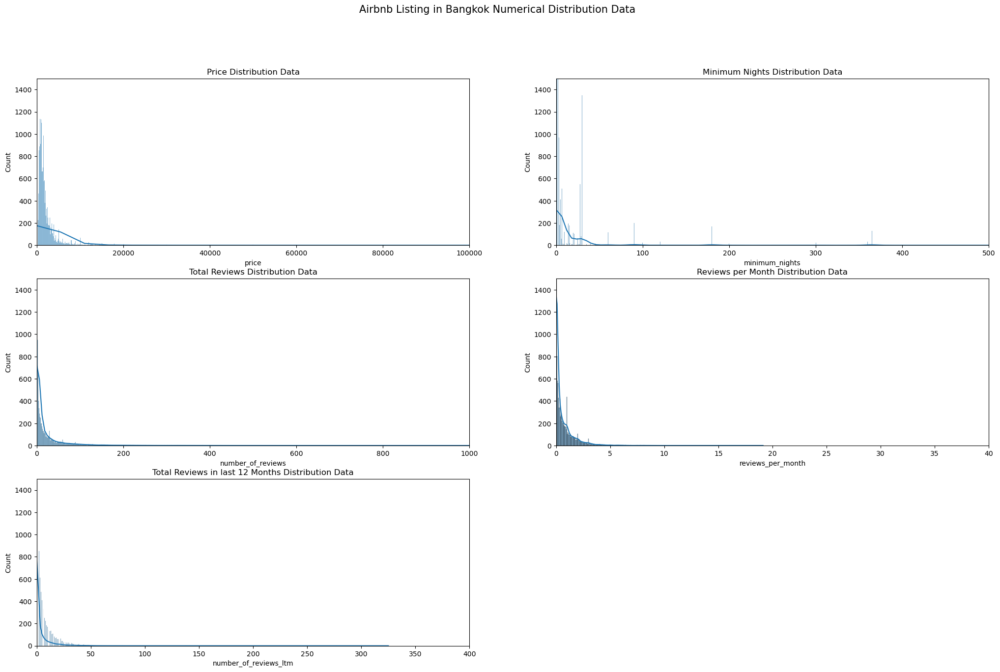

In [18]:
# Plot barplot
plt.figure(figsize = (25,15))
# Plot barplot
plt.subplot(3,2,1)
sns.histplot(data=df_clean,
                x='price',
                kde=True)
plt.xlim(0, 100000)
plt.ylim(0, 1500)
plt.title('Price Distribution Data')

plt.subplot(3,2,2)
sns.histplot(data=df_clean,
                x='minimum_nights',
                kde=True)
plt.xlim(0, 500)
plt.ylim(0, 1500)
plt.title('Minimum Nights Distribution Data')

plt.subplot(3,2,3)
sns.histplot(data=df_clean,
                x='number_of_reviews',
                kde=True)
plt.xlim(0, 1000)
plt.ylim(0, 1500)
plt.title('Total Reviews Distribution Data')

plt.subplot(3,2,4)
sns.histplot(data=df_clean,
                x='reviews_per_month',
                kde=True)
plt.xlim(0, 40)
plt.ylim(0, 1500)
plt.title('Reviews per Month Distribution Data')

plt.subplot(3,2,5)
sns.histplot(data=df_clean,
                x='number_of_reviews_ltm',
                kde=True)
plt.xlim(0, 400)
plt.ylim(0, 1500)
plt.title('Total Reviews in last 12 Months Distribution Data')

plt.suptitle('Airbnb Listing in Bangkok Numerical Distribution Data', fontsize=15)

#### Insight from Distribution Data Analysis

Data is distributed unevenly and form a right-skewed histogram plot, therefore the main central tendency of measurement using `median` as the main numerical data distribution reference and for data correlation test using Spearman Test

## Airbnb Bangkok Listing Map Visualization

In [19]:
# Generate a color mapping for each unique neighbourhood
neighbourhoods = df_clean['neighbourhood'].unique()
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 
          'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 
          'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
neighbourhood_color_map = {neigh: random.choice(colors) for neigh in neighbourhoods}

# Count total units per neighbourhood
total_unit = df_clean.groupby('neighbourhood')['id'].count().reset_index()

# Create Bangkok map
Bangkok_map = folium.Map(location=[df_clean['latitude'].mean(), df_clean['longitude'].mean()], zoom_start=12)
marker_cluster = MarkerCluster().add_to(Bangkok_map)

with open('Bangkok-districts.geojson', 'r') as file:
    bangkok_geojson = json.load(file)

# Create a Choropleth map based on neighbourhood colors
folium.Choropleth(
    geo_data=bangkok_geojson,
    data=total_unit,
    columns=["neighbourhood", "id"], 
    key_on="feature.properties.dname_e",  # based on field in GeoJSON
    fill_color="YlGnBu",  
    fill_opacity=0.6,
    line_opacity=0.8,
    legend_name="Total Units by Neighbourhood",
).add_to(Bangkok_map)

# Add marker cluster
marker_cluster = MarkerCluster().add_to(Bangkok_map)

# Add markers with colours matching the Choropleth map
for index, row in df_clean.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['name']}\nPrice: {row['price']}\nRoom Type: {row['room_type']}\n{row['neighbourhood']}",
        icon=folium.Icon(color=neighbourhood_color_map[row['neighbourhood']])  # Match marker color with neighbourhood
    ).add_to(marker_cluster)

# Show map
Bangkok_map

In [20]:
Bangkok_map_analysis = df_clean.groupby('neighbourhood').agg(
    median_price=('price', 'median'),
    avg_price=('price', 'mean'),
    total_listings=('id', 'count')
).reset_index().sort_values('median_price', ascending=False)

Bangkok_map_analysis.head(5)

,neighbourhood,median_price,avg_price,total_listings
27,Nong Chok,2539.00,3279.93,14
29,Parthum Wan,2400.00,4355.63,455
47,Vadhana,2000.00,4452.13,2153
39,Samphanthawong,2000.00,2667.05,114
8,Bang Rak,1850.00,3056.34,827


### Insight from `df_clean.describe()` and `Bangkok_map` Visualization

- `median` is always lower than `mean` due to right-skewed data distribution, therefore numerical analysis using `median` is more suitable for non-parametric distribution
- Nong Chok has the highest `median_price` but not the highest `avg_price` with only 14 units listed in Airbnb and not located in the metropolitan area
- Parthum Wan, Vadhana, and Bang Rak in the Top 5 highest median price which is in the heart of the metropolitan area, with Vadhana has the highest `total_listing` among the Top 5 list

> Metropolitan Neighbourhood List (based on google maps)
- Bang Rak
- Sathon
- Parthum Wan
- Khlong Toei
- Huai Khwang
- Yan na wa
- Ratchathewi
- Vadhana

## Data Correlation Analysis

- H0: there is no correlation between 2 data
- H1: there is enough evidence correlation between 2 data

margin of error = 0.05

- p-value > 0.05: failed to reject H0, there is enough evidence and proof to state that there is correlation between 2 data
- p-value < 0.05: reject H0, there is no enough evidence and proof to state that there is correlation between 2 data

### 1. Correlation of `median_price` with total units in every `neighbourhood`

,neighbourhood,median_price,avg_price,num_units
27,Nong Chok,2539.00,3279.93,14
29,Parthum Wan,2400.00,4355.63,455
47,Vadhana,2000.00,4452.13,2153
39,Samphanthawong,2000.00,2667.05,114
8,Bang Rak,1850.00,3056.34,827
34,Pom Prap Sattru Phai,1709.00,2577.59,123
22,Khlong Toei,1700.00,4249.33,2097
37,Ratchathewi,1536.00,3199.27,1114
43,Taling Chan,1502.50,2443.30,50
25,Lat Phrao,1500.00,3538.60,57


'Correlation Ratio: 0.16970573631392685 and the P-value: 0.2387093032265581'

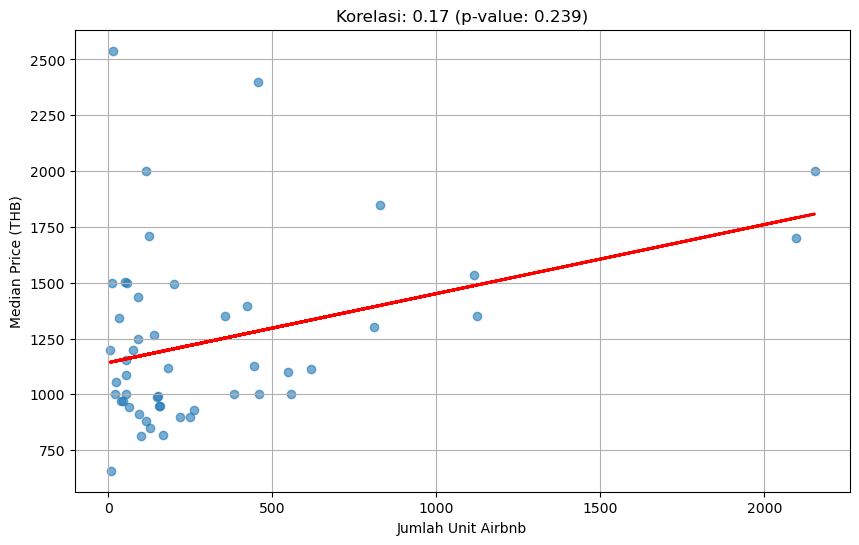

In [21]:
# Agregasi data per neighbourhood
neighbourhood_stats = df_clean.groupby('neighbourhood').agg(
    median_price=('price', 'median'),    # Harga median
    avg_price=('price', 'mean'),   # Harga rata-rata
    num_units=('id', 'count'),      # Jumlah unit
).reset_index().sort_values('median_price', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    neighbourhood_stats['num_units'],
    neighbourhood_stats['median_price']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=neighbourhood_stats['num_units'],
    y=neighbourhood_stats['median_price'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Jumlah Unit Airbnb')
plt.ylabel('Median Price (THB)')
plt.grid(True)

# Tambah trendline
z = np.polyfit(neighbourhood_stats['num_units'], neighbourhood_stats['median_price'], 1)
p = np.poly1d(z)
plt.plot(
    neighbourhood_stats['num_units'], 
    p(neighbourhood_stats['num_units']), 
    color='red',
    linewidth=2
)
display(neighbourhood_stats.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

**Insight**

p-value > 0.05, failed to reject H0. Therefore there is no enough evidence and proof to state that there is correlation between `median_price` and total units in every `neighbourhood`

### 2. Correlation of popularity (`number_of_reviews`,`last_reviews`,`reviews_per_month`,`number_of_reviews_ltm`) with `median_price` in every `neighbourhood`

#### Correlation `number_of_reviews` with `median_price` in every `neighbourhood`

,num_units,median_price,total_review
count,50.00,50.00,50.00
mean,317.08,1240.25,5280.70
std,461.25,398.97,8983.89
min,5.00,658.00,1.00
25%,55.50,970.38,158.25
50%,144.50,1117.00,1464.50
75%,412.00,1425.12,5996.00
max,2153.00,2539.00,41281.00


,neighbourhood,num_units,median_price,total_review
22,Khlong Toei,2097,1700.00,41281
47,Vadhana,2153,2000.00,37415
41,Sathon,809,1300.00,22242
37,Ratchathewi,1114,1536.00,20698
18,Huai Khwang,1125,1351.00,18145
8,Bang Rak,827,1850.00,17654
31,Phaya Thai,422,1394.00,13659
29,Parthum Wan,455,2400.00,9103
13,Chatu Chak,548,1100.00,8218
33,Phra Nakhon,619,1114.00,8142


'Correlation Ratio: 0.2948130089959034 and the P-value: 0.03767648844627914'

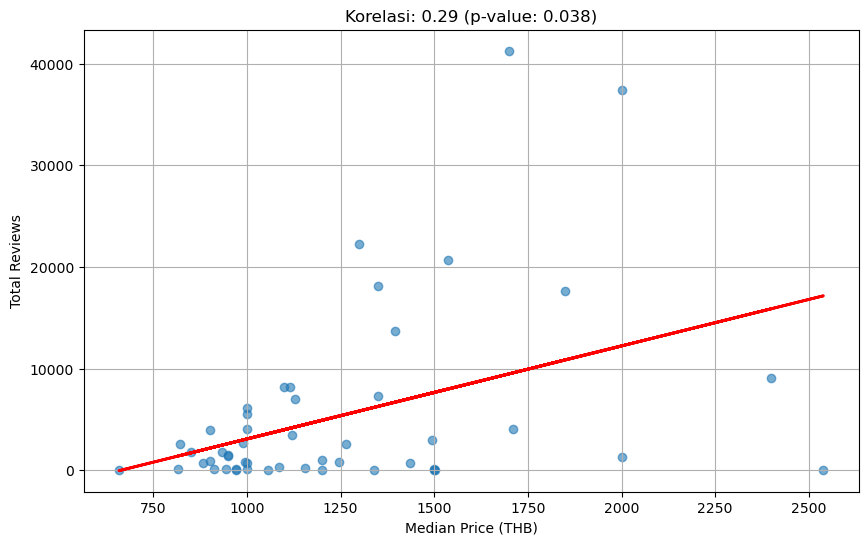

In [22]:
neighbourhood_total_review = df_clean.groupby('neighbourhood').agg(
    num_units=('id', 'count'),      # Jumlah unit
    median_price =('price', 'median'),    # Harga rata-rata
    total_review=('number_of_reviews', 'sum') # Total review
).reset_index().sort_values('total_review', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    neighbourhood_total_review['median_price'],
    neighbourhood_total_review['total_review']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=neighbourhood_total_review['median_price'],
    y=neighbourhood_total_review['total_review'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Total Reviews')
plt.grid(True)

# Tambah trendline
z = np.polyfit(neighbourhood_total_review['median_price'], neighbourhood_total_review['total_review'], 1)
p = np.poly1d(z)
plt.plot(
    neighbourhood_total_review['median_price'], 
    p(neighbourhood_total_review['median_price']), 
    color='red',
    linewidth=2
)
display(neighbourhood_total_review.describe())
display(neighbourhood_total_review.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()


**Insight**

- p-value < 0.05, reject H0. Therefore there is enough evidence and proof to state that there is correlation between `median_price` and `number_of_reviews` in every `neighbourhood`
- Correlation coeficient = 0.29. With a correlation coefficient of 0.29, there is a positive correlation between the two variables. This indicates that as the total number of reviews increases, the median price tends to rise as well. In other words, properties with a higher number of reviews are associated with higher median prices.

#### Correlation `reviews_per_month` with `median_price` in every `neighbourhood`

,num_units,median_price,routine_review
count,50.00,50.00,50.00
mean,317.08,1240.25,0.05
std,461.25,398.97,0.08
min,5.00,658.00,0.00
25%,55.50,970.38,0.00
50%,144.50,1117.00,0.02
75%,412.00,1425.12,0.07
max,2153.00,2539.00,0.37


,neighbourhood,num_units,median_price,routine_review
22,Khlong Toei,2097,1700.00,0.37
41,Sathon,809,1300.00,0.29
29,Parthum Wan,455,2400.00,0.20
37,Ratchathewi,1114,1536.00,0.17
34,Pom Prap Sattru Phai,123,1709.00,0.16
47,Vadhana,2153,2000.00,0.16
8,Bang Rak,827,1850.00,0.13
18,Huai Khwang,1125,1351.00,0.11
31,Phaya Thai,422,1394.00,0.10
9,Bang Sue,250,900.00,0.08


'Correlation Ratio: 0.33589578024747674 and the P-value: 0.017087809403321594'

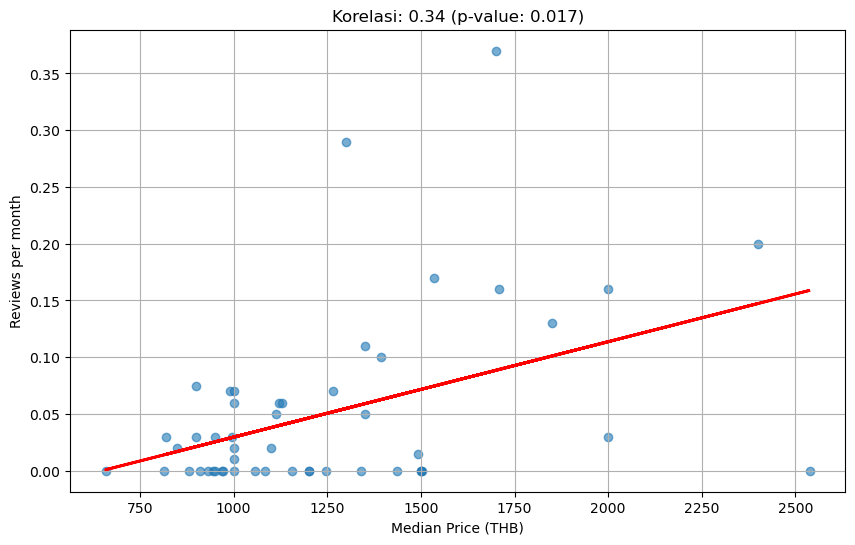

In [23]:
neighbourhood_review_per_month = df_clean.groupby('neighbourhood').agg(
    num_units=('id', 'count'),      # Jumlah unit
    median_price =('price', 'median'),    # Harga rata-rata
    routine_review=('reviews_per_month', 'median') # Total review
).reset_index().sort_values('routine_review', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    neighbourhood_review_per_month['median_price'],
    neighbourhood_review_per_month['routine_review']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=neighbourhood_review_per_month['median_price'],
    y=neighbourhood_review_per_month['routine_review'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Reviews per month')
plt.grid(True)

# Tambah trendline
z = np.polyfit(neighbourhood_review_per_month['median_price'], neighbourhood_review_per_month['routine_review'], 1)
p = np.poly1d(z)
plt.plot(
    neighbourhood_review_per_month['median_price'], 
    p(neighbourhood_review_per_month['median_price']), 
    color='red',
    linewidth=2
)
display(neighbourhood_review_per_month.describe())
display(neighbourhood_review_per_month.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

**Insight**

- p-value < 0.05, then failed reject H0. Therefore there is enough evidence and proof to state that there is correlation between `median_price` and `reviews_per_month` in every `neighbourhood`
- Correlation coeficient = 0.34. With a correlation coefficient of 0.34, there is a positive correlation between the two variables. This indicates that as the average reviews per month increases, the median price tends to rise as well. In other words, properties with a higher reviews per month are associated with higher median prices.

#### Correlation `number_of_reviews_ltm` with `median_price` in every `neighbourhood`

,neighbourhood,num_units,median_price,recent_review,total_recent_review
22,Khlong Toei,2097,1700.00,2.00,13601
29,Parthum Wan,455,2400.00,1.00,1670
41,Sathon,809,1300.00,1.00,3232
0,Bang Bon,5,1200.00,0.00,0
37,Ratchathewi,1114,1536.00,0.00,4455
28,Nong Khaem,9,658.00,0.00,0
30,Phasi Charoen,155,950.00,0.00,263
31,Phaya Thai,422,1394.00,0.00,2059
32,Phra Khanong,558,1000.00,0.00,1271
33,Phra Nakhon,619,1114.00,0.00,1799


'Correlation Ratio: 0.2896215067129968 and the P-value: 0.04134157980696382'

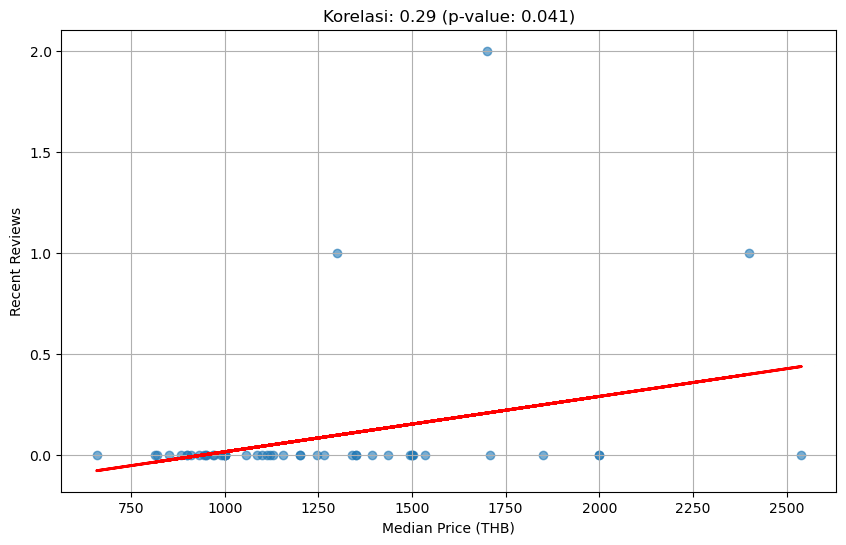

In [24]:
neighbourhood_review_ltm = df_clean.groupby('neighbourhood').agg(
    num_units=('id', 'count'),      # Jumlah unit
    median_price =('price', 'median'),    # Harga rata-rata
    recent_review=('number_of_reviews_ltm', 'median'), # Total review
    total_recent_review=('number_of_reviews_ltm', 'sum')
).reset_index().sort_values('recent_review', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    neighbourhood_review_ltm['median_price'],
    neighbourhood_review_ltm['recent_review']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=neighbourhood_review_ltm['median_price'],
    y=neighbourhood_review_ltm['recent_review'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Recent Reviews')
plt.grid(True)

# Tambah trendline
z = np.polyfit(neighbourhood_review_ltm['median_price'], neighbourhood_review_ltm['recent_review'], 1)
p = np.poly1d(z)
plt.plot(
    neighbourhood_review_ltm['median_price'], 
    p(neighbourhood_review_ltm['median_price']), 
    color='red',
    linewidth=2
)
display(neighbourhood_review_ltm.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

**Insight**

- p-value < 0.05, then failed reject H0. Therefore there is enough evidence and proof to state that there is correlation between `median_price` and `number_of_reviews_ltm` in every `neighbourhood`
- Correlation coeficient = 0.29. With a correlation coefficient of 0.29, there is a positive correlation between the two variables. This indicates that as the total number of reviews in last 12 months increases, the median price tends to rise as well. In other words, properties with a higher number of reviews are associated with higher median prices.

#### Correlation `last_review` with `median_price` in every `neighbourhood`

In [25]:
import datetime

analysis_date = df_clean['last_review'].max() + datetime.timedelta(1)
analysis_date

Timestamp('2022-12-29 00:00:00')

In [26]:
df_clean['recency'] = (analysis_date - df_clean['last_review']).dt.days

,neighbourhood,num_units,median_price,last_review,avg_last_review
22,Khlong Toei,2097,1700.00,75.00,2968.30
41,Sathon,809,1300.00,148.00,3757.89
29,Parthum Wan,455,2400.00,357.00,3939.82
47,Vadhana,2153,2000.00,400.00,4459.32
37,Ratchathewi,1114,1536.00,1011.00,4005.73
34,Pom Prap Sattru Phai,123,1709.00,1026.00,4325.14
9,Bang Sue,250,900.00,1042.50,4775.12
8,Bang Rak,827,1850.00,1051.00,3909.46
18,Huai Khwang,1125,1351.00,1063.00,4542.16
31,Phaya Thai,422,1394.00,1085.00,3808.53


'Correlation Ratio: -0.3055827004550909 and the P-value: 0.030923333498863'

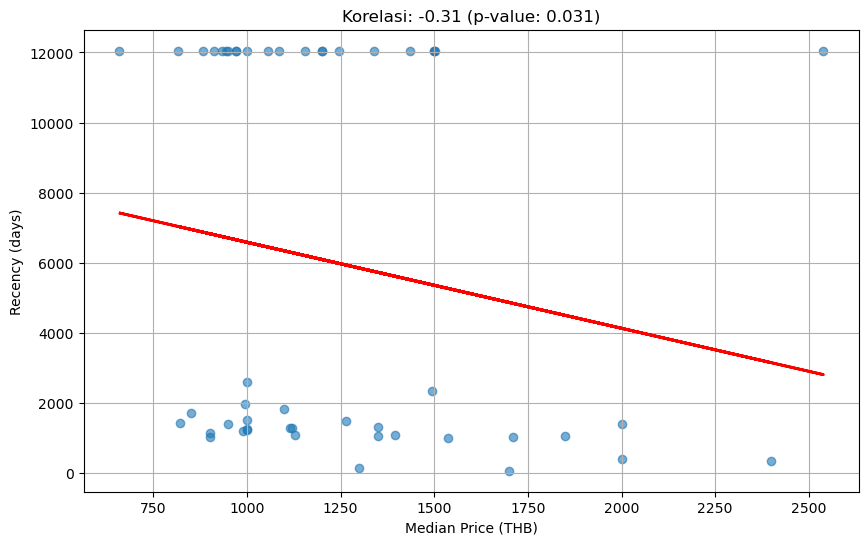

In [27]:
neighbourhood_last_review = df_clean.groupby('neighbourhood').agg(
    num_units=('id', 'count'),      # Jumlah unit
    median_price =('price', 'median'),    # Harga rata-rata
    last_review=('recency', 'median'), # Total review
    avg_last_review=('recency', 'mean')
).reset_index().sort_values('last_review', ascending=True)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    neighbourhood_last_review['median_price'],
    neighbourhood_last_review['last_review']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=neighbourhood_last_review['median_price'],
    y=neighbourhood_last_review['last_review'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Recency (days)')
plt.grid(True)

# Tambah trendline
z = np.polyfit(neighbourhood_last_review['median_price'], neighbourhood_last_review['last_review'], 1)
p = np.poly1d(z)
plt.plot(
    neighbourhood_last_review['median_price'], 
    p(neighbourhood_last_review['median_price']), 
    color='red',
    linewidth=2
)
display(neighbourhood_last_review.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

**Insight**

- p-value < 0.05, then failed reject H0. Therefore there is enough evidence and proof to state that there is correlation between `median_price` and `last_review` in every `neighbourhood`
- Correlation coeficient = -0.31. With a correlation coefficient of -0.31, there is an inverse correlation, indicating that as the date of the last review approaches, the median price tends to increase. This suggests that more recent reviews are associated with higher median prices, reflecting a potential pattern where properties with fresher feedback may command higher prices.

### 3. Correlation of total units per `host_name` with `median_price` and `number_of_reviews`

#### Correlation  total units per `host_name` with `median_price`

,host_name,num_units,median_price,median_review,avg_review,total_review
808,Curry,228,1468.50,12.00,20.65,4708
2578,Noons,99,1971.00,8.00,14.88,1473
1537,K,91,1150.00,10.00,32.55,2962
3262,Pornchai,63,550.00,0.00,0.13,8
398,Bee,62,1730.00,10.00,45.53,2823
916,Dusadee,62,3199.00,1.00,3.76,233
84,Alex,62,1429.00,9.00,40.94,2538
934,Ed,60,2150.00,16.50,46.95,2817
2317,Nana,57,2043.00,6.00,10.37,591
2010,Ludoping,56,1839.50,12.00,19.93,1116


'Correlation Ratio: -0.008650218797749945 and the P-value: 0.5284455193402093'

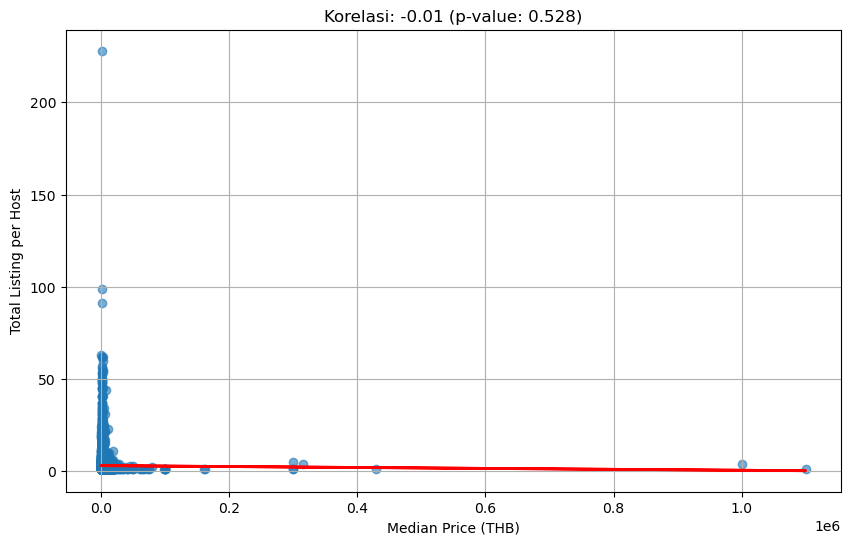

In [28]:
host_listing_price = df_clean.groupby('host_name').agg(
    num_units=('id', 'count'),      # Jumlah unit
    median_price =('price', 'median'),    # Harga rata-rata
    median_review=('number_of_reviews', 'median'), # Total review
    avg_review=('number_of_reviews', 'mean'),
    total_review = ('number_of_reviews', 'sum')
).reset_index().sort_values('num_units', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    host_listing_price['median_price'],
    host_listing_price['num_units']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=host_listing_price['median_price'],
    y=host_listing_price['num_units'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Total Listing per Host')
plt.grid(True)

# Tambah trendline
z = np.polyfit(host_listing_price['median_price'], host_listing_price['num_units'], 1)
p = np.poly1d(z)
plt.plot(
    host_listing_price['median_price'], 
    p(host_listing_price['median_price']), 
    color='red',
    linewidth=2
)
display(host_listing_price.head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

**Insight**

p-value > 0.05, then reject H0. Therefore there is no enough evidence and proof to state that there is correlation between `median_price` and total units per `host_name`

#### Correlation  total units per `host_name` with `number_of_reviews`

,host_name,num_units,median_price,median_review,avg_review,total_review
808,Curry,228,1468.50,12.00,20.65,4708
2578,Noons,99,1971.00,8.00,14.88,1473
1537,K,91,1150.00,10.00,32.55,2962
3262,Pornchai,63,550.00,0.00,0.13,8
398,Bee,62,1730.00,10.00,45.53,2823
916,Dusadee,62,3199.00,1.00,3.76,233
84,Alex,62,1429.00,9.00,40.94,2538
934,Ed,60,2150.00,16.50,46.95,2817
2317,Nana,57,2043.00,6.00,10.37,591
2010,Ludoping,56,1839.50,12.00,19.93,1116


'Correlation Ratio: 0.5348124368817202 and the P-value: 0.0'

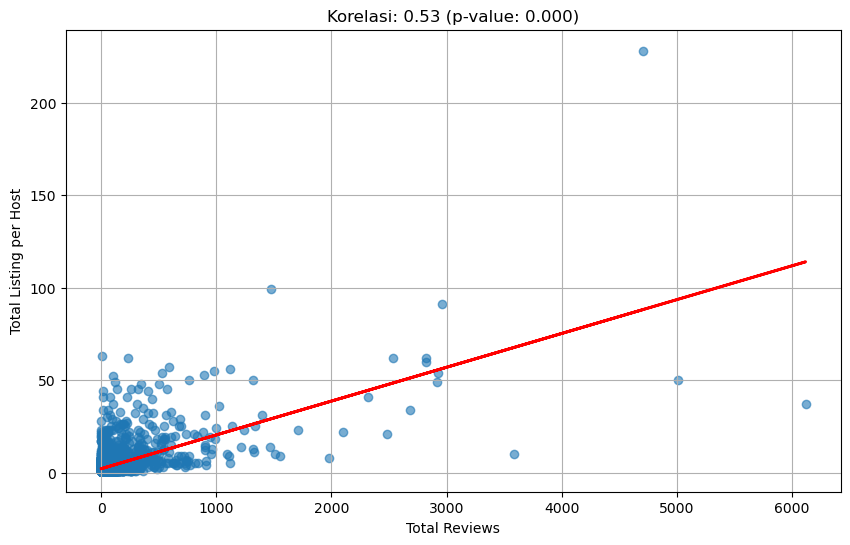

In [29]:
host_listing_reviews = df_clean.groupby('host_name').agg(
    num_units=('id', 'count'),                # Jumlah unit per host & area
    median_price=('price', 'median'),         # Harga median
    median_review=('number_of_reviews', 'median'),  # Median ulasan
    avg_review=('number_of_reviews', 'mean'), # Rata-rata ulasan
    total_review=('number_of_reviews', 'sum') # Total ulasan
).reset_index().sort_values('num_units', ascending=False)

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    host_listing_reviews['total_review'],
    host_listing_reviews['num_units']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=host_listing_reviews['total_review'],
    y=host_listing_reviews['num_units'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Total Reviews')
plt.ylabel('Total Listing per Host')
plt.grid(True)

# Tambah trendline
z = np.polyfit(host_listing_reviews['total_review'], host_listing_reviews['num_units'], 1)
p = np.poly1d(z)
plt.plot(
    host_listing_reviews['total_review'], 
    p(host_listing_reviews['total_review']), 
    color='red',
    linewidth=2
)
display(host_listing_reviews.head(20))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()


**Insight**

- p-value < 0.05, then failed reject H0. Therefore there is enough evidence and proof to state that there is correlation between `median_price` and `number_of_reviews_ltm` in every `neighbourhood`
- Correlation coeficient = 0.53. With a correlation coefficient of 0.53, there is a positive correlation, meaning that as the total number of listings for each host increases, the total number of reviews tends to increase as well. This suggests that hosts with more listings generally receive a higher volume of reviews, indicating a direct relationship between the number of listings and the number of reviews. In business case, if the host have many listings, this can indicate the host can afford the marketing strategy to increase and boost the revenue through higher price

### Conclusion of Data Correlation

- There is **No** correlation between `price` data and total listing in every neighbourhood and also there is **No** correlation between price data and total listing per `host_name`. 
- There is positive correlation between total listing per `host_name` and `number_of_reviews` due to higher financial statement to afford intensive marketing activities
- There is positive correlation between `median_price` and `number_of_reviews`, `reviews_per_month` and `number_of_reviews_ltm`. On the other hand, there is negative correlation between `median_price` and `last_reviews`


## 1. Analysis of Best Neighbourhood Recommendation

### Pricing Neighbourhood Analysis

Provide feature engineering `revenue_at_least`

In [30]:
df_clean['revenue_at_least'] = df_clean['price'] * df_clean['minimum_nights'] * df_clean['number_of_reviews']

df_clean

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,recency,revenue_at_least
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.76,100.54,Entire home/apt,1905,3,65,2020-01-06,0.50,2,0,1088,371475
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.67,100.62,Private room,1316,1,0,1990-01-01,0.00,2,0,12050,0
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75,100.62,Private room,800,60,0,1990-01-01,0.00,1,0,12050,0
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.79,100.57,Private room,1286,7,2,2022-04-01,0.03,1,1,272,18004
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.77,100.63,Private room,1905,1,0,1990-01-01,0.00,3,0,12050,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.72,100.65,Private room,2298,28,0,1990-01-01,0.00,1,0,12050,0
15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.75,100.54,Private room,1429,1,0,1990-01-01,0.00,14,0,12050,0
15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.75,100.54,Private room,1214,1,0,1990-01-01,0.00,14,0,12050,0
15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.75,100.54,Private room,1214,1,0,1990-01-01,0.00,14,0,12050,0


In [31]:
# 1. Analisis Neighborhood Dengan harga
neighbourhood_price_analysis = df_clean.groupby('neighbourhood').agg(
    median_price=('price', 'median'),
    avg_price=('price', 'mean'),
    max_price=('price', 'max'),
    total_occupancy=('number_of_reviews', 'sum'),
    total_listings=('id', 'count'),
    median_min_night = ('minimum_nights', 'median'),
    avg_min_night = ('minimum_nights', 'mean'),
    revenue_at_least = ('revenue_at_least', 'sum'),
    avg_revenue_at_least = ('revenue_at_least', 'mean'),
    median_revenue_at_least = ('revenue_at_least', 'median')
).reset_index()



display(df_clean[['price','minimum_nights']].describe())
display(neighbourhood_price_analysis.sort_values('revenue_at_least', ascending=False).head(10))
display(neighbourhood_price_analysis.sort_values('median_revenue_at_least', ascending=False).head(10))

,price,minimum_nights
count,15854.00,15854.00
mean,3217.70,15.29
std,24972.12,50.82
min,0.00,1.00
25%,900.00,1.00
50%,1429.00,1.00
75%,2429.00,7.00
max,1100000.00,1125.00


,neighbourhood,median_price,avg_price,max_price,total_occupancy,total_listings,median_min_night,avg_min_night,revenue_at_least,avg_revenue_at_least,median_revenue_at_least
18,Huai Khwang,1351.00,5036.08,1000000,18145,1125,2.00,16.18,10108040985,8984925.32,6202.00
22,Khlong Toei,1700.00,4249.33,1000000,41281,2097,2.00,14.10,1537911832,733386.66,25280.00
29,Parthum Wan,2400.00,4355.63,300000,9103,455,1.00,20.98,1247878810,2742590.79,21600.00
6,Bang Na,1000.00,2060.00,90000,5570,458,3.00,30.12,801006583,1748922.67,6728.00
47,Vadhana,2000.00,4452.13,1100000,37415,2153,2.00,15.50,642846600,298581.79,17433.00
37,Ratchathewi,1536.00,3199.27,300000,20698,1114,2.00,13.38,363661252,326446.37,12325.00
41,Sathon,1300.00,2338.24,200000,22242,809,1.00,13.32,279071137,344958.14,10296.00
45,Thon buri,1120.00,2759.45,161516,3457,182,3.00,20.28,274075215,1505907.77,9104.00
13,Chatu Chak,1100.00,2294.39,122594,8218,548,2.00,21.31,233137290,425433.01,1730.50
8,Bang Rak,1850.00,3056.34,300000,17654,827,1.00,12.35,228569374,276383.77,9680.00


,neighbourhood,median_price,avg_price,max_price,total_occupancy,total_listings,median_min_night,avg_min_night,revenue_at_least,avg_revenue_at_least,median_revenue_at_least
22,Khlong Toei,1700.00,4249.33,1000000,41281,2097,2.00,14.10,1537911832,733386.66,25280.00
29,Parthum Wan,2400.00,4355.63,300000,9103,455,1.00,20.98,1247878810,2742590.79,21600.00
47,Vadhana,2000.00,4452.13,1100000,37415,2153,2.00,15.50,642846600,298581.79,17433.00
4,Bang Kho laen,1265.00,2408.11,14630,2618,140,2.00,37.83,112026509,800189.35,14409.00
37,Ratchathewi,1536.00,3199.27,300000,20698,1114,2.00,13.38,363661252,326446.37,12325.00
36,Rat Burana,1000.00,1603.25,10000,675,53,15.00,29.91,14752235,278344.06,10528.00
41,Sathon,1300.00,2338.24,200000,22242,809,1.00,13.32,279071137,344958.14,10296.00
31,Phaya Thai,1394.00,1793.91,15000,13659,422,1.00,11.63,139481338,330524.50,10268.00
8,Bang Rak,1850.00,3056.34,300000,17654,827,1.00,12.35,228569374,276383.77,9680.00
45,Thon buri,1120.00,2759.45,161516,3457,182,3.00,20.28,274075215,1505907.77,9104.00


Text(0.5, 0.98, 'Top 5 Neighbourhoods Based on Pricing Neighbourhood Analysis')

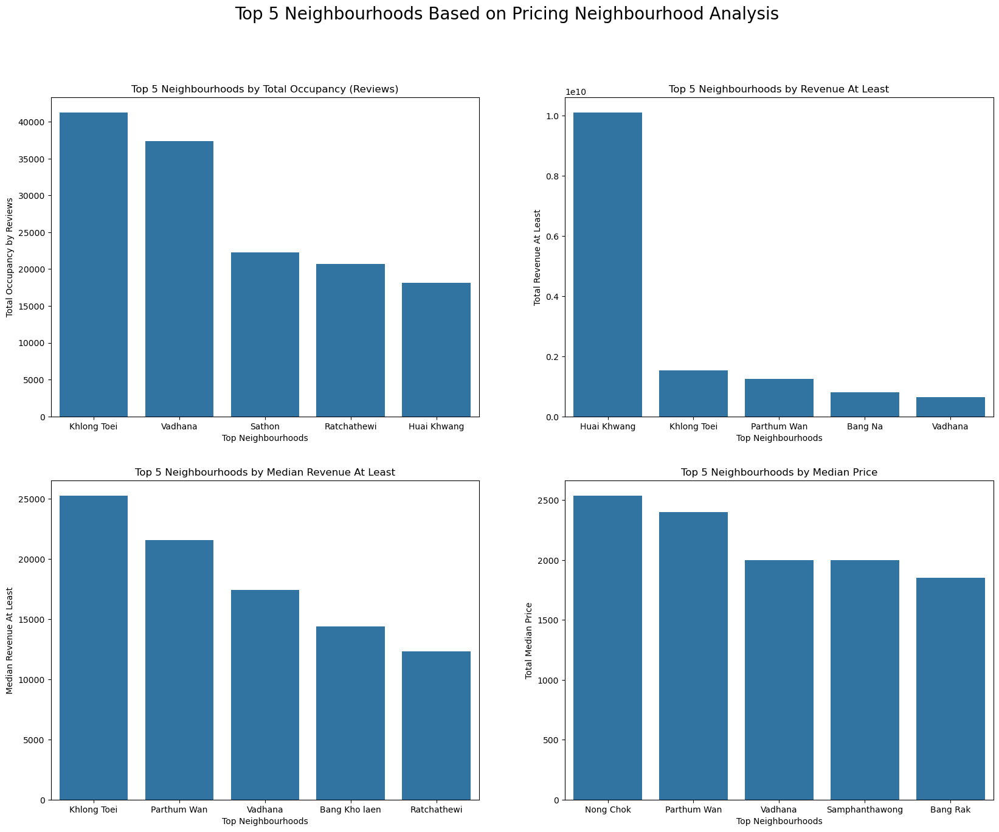

In [32]:
# Sort descending top 5
top5_total_revenue = neighbourhood_price_analysis.sort_values(by='revenue_at_least', ascending=False).head(5)

# Sort descending top 5
top5_median_revenue = neighbourhood_price_analysis.sort_values(by='median_revenue_at_least', ascending=False).head(5)

# Sort descending top 5
top5_occupancy = neighbourhood_price_analysis.sort_values(by='total_occupancy', ascending=False).head(5)

# Sort descending top 5
top5_median_price = neighbourhood_price_analysis.sort_values(by='median_price', ascending=False).head(5)

# Plot barplot
plt.figure(figsize = (20,15))
# Plot barplot
plt.subplot(2,2,1)
sns.barplot(data=top5_occupancy, 
            x='neighbourhood', 
            y='total_occupancy',
            order=top5_occupancy['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Occupancy by Reviews')
plt.title('Top 5 Neighbourhoods by Total Occupancy (Reviews)')

plt.subplot(2,2,2)
sns.barplot(data=top5_total_revenue, 
            x='neighbourhood', 
            y='revenue_at_least', 
            order=top5_total_revenue['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Revenue At Least')
plt.title('Top 5 Neighbourhoods by Revenue At Least')

# Plot barplot
plt.subplot(2,2,3)
sns.barplot(data=top5_median_revenue, 
            x='neighbourhood', 
            y='median_revenue_at_least', 
            order=top5_median_revenue['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Median Revenue At Least')
plt.title('Top 5 Neighbourhoods by Median Revenue At Least')

plt.subplot(2,2,4)
sns.barplot(data=top5_median_price, 
            x='neighbourhood', 
            y='median_price', 
            order=top5_median_price['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Median Price')
plt.title('Top 5 Neighbourhoods by Median Price')

plt.suptitle('Top 5 Neighbourhoods Based on Pricing Neighbourhood Analysis', fontsize=20)


#### Insight of Pricing Neighbourhood Analysis

- `revenue_at_least` is the way to get information related market capitalization prediction for each `neighbourhood` and to describe economic condition. Calculated from `price` * `minimum_nights` * `number_of_reviews`
- Huai Khwang is neighbourhood with the highest `revenue_at_least` with more than THB 10 billion, with over 6 times larger than Khlong Toei which is the second highest `revenue_at_least` with around THB 1.53 billion
- Huai Khwang listing price distribution is very right skewed, as the `median_price` is 1351 but the `avg_price` is 5036.
- Although Huai Khwang is the highest revenue, the `median_revenue_at_least` only THB 6202 which is quite low
- Khlong Toei is the highest `median_revenue_at_least`, which mean the revenue distribution is better
- Khlong Toei has the highest `total_occupancy` calculated from `number_of_reviews`


### Popularity Neighbourhood Analysis

In [33]:
neighbourhood_analysis = df_clean.groupby('neighbourhood').agg(
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_reviews_per_month=('reviews_per_month', 'median'),
    avg_reviews_per_month=('reviews_per_month', 'mean'),
    total_reviews_per_month=('reviews_per_month', 'sum'),
    recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    avg_last_review = ('recency', 'mean'),
    median_last_review = ('recency', 'median'),
    total_listings=('id', 'count')
).reset_index()

# Rekomendasi neighbourhood (top 5)
top_neighbourhoods = neighbourhood_analysis.sort_values(
    by=['median_reviews', 'median_reviews_per_month', 'recent_reviews', 'median_last_review'],
    ascending=False
).head(10)

display(df_clean[['number_of_reviews','reviews_per_month', 'number_of_reviews_ltm']].describe())
display(top_neighbourhoods)

,number_of_reviews,reviews_per_month,number_of_reviews_ltm
count,15854.00,15854.00,15854.00
mean,16.65,0.52,3.48
std,40.61,0.95,8.92
min,0.00,0.00,0.00
25%,0.00,0.00,0.00
50%,2.00,0.09,0.00
75%,13.00,0.67,3.00
max,1224.00,19.13,325.00


,neighbourhood,median_reviews,avg_reviews,total_reviews,median_reviews_per_month,avg_reviews_per_month,total_reviews_per_month,recent_reviews,avg_recent_reviews,total_recent_reviews,avg_last_review,median_last_review,total_listings
22,Khlong Toei,5.00,19.69,41281,0.37,0.87,1814.89,2.00,6.49,13601,2968.30,75.00,2097
41,Sathon,4.00,27.49,22242,0.29,0.66,536.28,1.00,4.00,3232,3757.89,148.00,809
34,Pom Prap Sattru Phai,4.00,33.02,4062,0.16,0.66,81.14,0.00,5.93,730,4325.14,1026.00,123
31,Phaya Thai,4.00,32.37,13659,0.10,0.55,232.60,0.00,4.88,2059,3808.53,1085.00,422
37,Ratchathewi,3.00,18.58,20698,0.17,0.54,606.25,0.00,4.00,4455,4005.73,1011.00,1114
8,Bang Rak,3.00,21.35,17654,0.13,0.56,460.39,0.00,4.14,3420,3909.46,1051.00,827
29,Parthum Wan,2.00,20.01,9103,0.20,0.53,239.77,1.00,3.67,1670,3939.82,357.00,455
47,Vadhana,2.00,17.38,37415,0.16,0.64,1386.19,0.00,4.51,9709,4459.32,400.00,2153
18,Huai Khwang,2.00,16.13,18145,0.11,0.48,538.73,0.00,2.27,2557,4542.16,1063.00,1125
9,Bang Sue,2.00,15.87,3968,0.08,0.45,111.51,0.00,3.29,823,4775.12,1042.50,250


Text(0.5, 0.98, 'Top 5 Neighbourhoods Based on Popularity Neighbourhood Analysis')

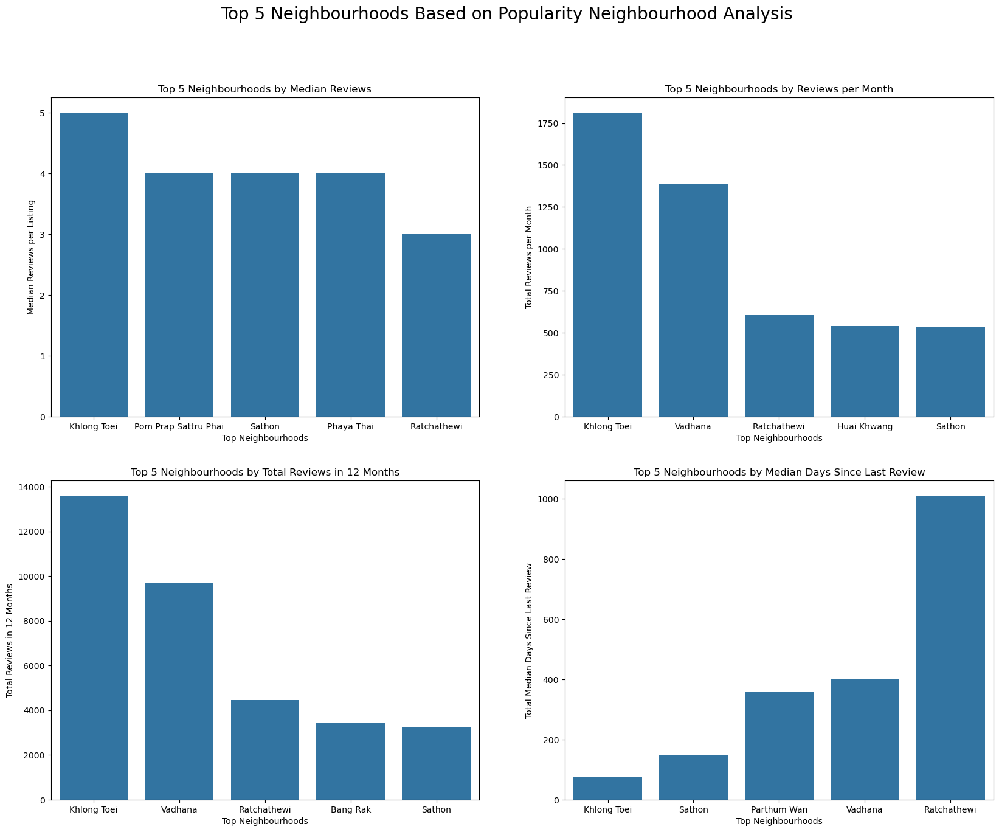

In [34]:
# Sort descending top 5
top5_median_reviews = neighbourhood_analysis.sort_values(by='median_reviews', ascending=False).head(5)

# Sort descending top 5
top5_monthly_reviews = neighbourhood_analysis.sort_values(by='total_reviews_per_month', ascending=False).head(5)

# Sort descending top 5
top5_recent_reviews = neighbourhood_analysis.sort_values(by='total_recent_reviews', ascending=False).head(5)

# Sort descending top 5
top5_median_last_review = neighbourhood_analysis.sort_values(by='median_last_review', ascending=True).head(5)

# Plot barplot
plt.figure(figsize = (20,15))
# Plot barplot
plt.subplot(2,2,1)
sns.barplot(data=top5_median_reviews, 
            x='neighbourhood', 
            y='median_reviews',
            order=top5_median_reviews['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Median Reviews per Listing')
plt.title('Top 5 Neighbourhoods by Median Reviews')

plt.subplot(2,2,2)
sns.barplot(data=top5_monthly_reviews, 
            x='neighbourhood', 
            y='total_reviews_per_month', 
            order=top5_monthly_reviews['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Reviews per Month')
plt.title('Top 5 Neighbourhoods by Reviews per Month')

# Plot barplot
plt.subplot(2,2,3)
sns.barplot(data=top5_recent_reviews, 
            x='neighbourhood', 
            y='total_recent_reviews', 
            order=top5_recent_reviews['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Reviews in 12 Months')
plt.title('Top 5 Neighbourhoods by Total Reviews in 12 Months')

plt.subplot(2,2,4)
sns.barplot(data=top5_median_last_review, 
            x='neighbourhood', 
            y='median_last_review', 
            order=top5_median_last_review['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Median Days Since Last Review')
plt.title('Top 5 Neighbourhoods by Median Days Since Last Review')

plt.suptitle('Top 5 Neighbourhoods Based on Popularity Neighbourhood Analysis', fontsize=20)


#### Insight of Popularity Neighbourhood Analysis

- Khlong Toei is the neighbourhood which dominate the popularity analysis due to the top of: 
    + `median_reviews`
    + `total_reviews`
    + `median_reviews_per_month`
    + `avg_reviews_per_month`
    + `total_reviews_per_month`
    + `recent_reviews`
    + `avg_recent_reviews`
    + `total_recent_reviews`

- The domination in `total_recent_reviews` makes Khlong Toei the most popular `neighbourhood` for the last 12 months which make the opportunity to list an Airbnb is wide open due to big opportunity in the popular `neighbourhood`


### Risk Management - Empty Ratio Analysis

Provide feature engineering to add `empty_listing` data

In [35]:
df_clean['empty_listing'] = df_clean['number_of_reviews'].apply(lambda x: 1 if x == 0 else 0)

,total_empty_listing,median_price,median_reviews,avg_reviews,total_reviews,median_reviews_per_month,avg_reviews_per_month,total_reviews_per_month,recent_reviews,avg_recent_reviews,total_recent_reviews,avg_last_review,median_last_review,total_listings,empty_ratio
count,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00
mean,115.80,1240.25,1.13,10.98,5280.70,0.05,0.30,163.67,0.08,1.92,1103.92,6358.38,5999.51,317.08,0.50
std,138.42,398.97,1.30,8.40,8983.89,0.08,0.21,335.16,0.34,1.66,2424.12,1936.91,5434.16,461.25,0.16
min,4.00,658.00,0.00,0.11,1.00,0.00,0.00,0.03,0.00,0.00,0.00,2968.30,75.00,5.00,0.23
25%,36.25,970.38,0.00,3.25,158.25,0.00,0.13,7.54,0.00,0.57,38.25,4915.65,1213.38,55.50,0.37
50%,63.00,1117.00,1.00,10.81,1464.50,0.02,0.28,40.19,0.00,1.53,199.50,6083.14,1902.50,144.50,0.48
75%,136.75,1425.12,2.00,16.06,5996.00,0.07,0.44,150.25,0.00,2.80,933.25,7609.55,12050.00,412.00,0.61
max,755.00,2539.00,5.00,33.02,41281.00,0.37,0.87,1814.89,2.00,6.49,13601.00,10839.11,12050.00,2153.00,0.89


,neighbourhood,total_empty_listing,median_price,median_reviews,avg_reviews,total_reviews,median_reviews_per_month,avg_reviews_per_month,total_reviews_per_month,recent_reviews,avg_recent_reviews,total_recent_reviews,avg_last_review,median_last_review,total_listings,empty_ratio
22,Khlong Toei,477,1700.00,5.00,19.69,41281,0.37,0.87,1814.89,2.00,6.49,13601,2968.30,75.00,2097,0.23
31,Phaya Thai,117,1394.00,4.00,32.37,13659,0.10,0.55,232.60,0.00,4.88,2059,3808.53,1085.00,422,0.28
8,Bang Rak,241,1850.00,3.00,21.35,17654,0.13,0.56,460.39,0.00,4.14,3420,3909.46,1051.00,827,0.29
41,Sathon,236,1300.00,4.00,27.49,22242,0.29,0.66,536.28,1.00,4.00,3232,3757.89,148.00,809,0.29
29,Parthum Wan,138,2400.00,2.00,20.01,9103,0.20,0.53,239.77,1.00,3.67,1670,3939.82,357.00,455,0.30
37,Ratchathewi,342,1536.00,3.00,18.58,20698,0.17,0.54,606.25,0.00,4.00,4455,4005.73,1011.00,1114,0.31
34,Pom Prap Sattru Phai,41,1709.00,4.00,33.02,4062,0.16,0.66,81.14,0.00,5.93,730,4325.14,1026.00,123,0.33
36,Rat Burana,18,1000.00,1.00,12.74,675,0.02,0.21,10.99,0.00,0.85,45,4679.40,1525.00,53,0.34
18,Huai Khwang,389,1351.00,2.00,16.13,18145,0.11,0.48,538.73,0.00,2.27,2557,4542.16,1063.00,1125,0.35
47,Vadhana,755,2000.00,2.00,17.38,37415,0.16,0.64,1386.19,0.00,4.51,9709,4459.32,400.00,2153,0.35


'Correlation Ratio: -0.2858275909073639 and the P-value: 0.044200863706583784'

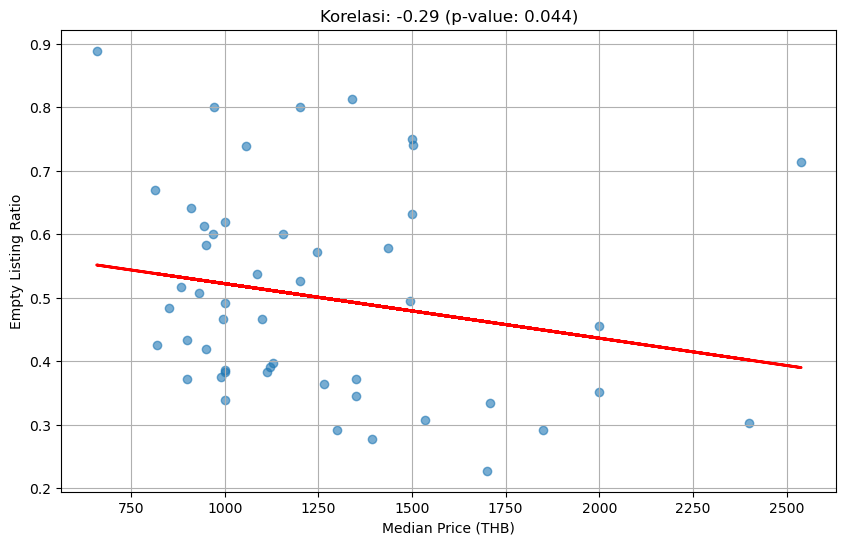

In [36]:
empty_ratio = df_clean.groupby('neighbourhood').agg(
    total_empty_listing=('empty_listing', 'sum'),
    median_price=('price', 'median'),
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_reviews_per_month=('reviews_per_month', 'median'),
    avg_reviews_per_month=('reviews_per_month', 'mean'),
    total_reviews_per_month=('reviews_per_month', 'sum'),
    recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    avg_last_review = ('recency', 'mean'),
    median_last_review = ('recency', 'median'),
    total_listings=('id', 'count')
).reset_index()
empty_ratio['empty_ratio'] = empty_ratio['total_empty_listing'] / empty_ratio['total_listings']

# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    empty_ratio['median_price'],
    empty_ratio['empty_ratio']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=empty_ratio['median_price'],
    y=empty_ratio['empty_ratio'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Price (THB)')
plt.ylabel('Empty Listing Ratio')
plt.grid(True)

# Tambah trendline
z = np.polyfit(empty_ratio['median_price'], empty_ratio['empty_ratio'], 1)
p = np.poly1d(z)
plt.plot(
    empty_ratio['median_price'], 
    p(empty_ratio['median_price']), 
    color='red',
    linewidth=2
)

display(empty_ratio.describe())
display(empty_ratio.sort_values('empty_ratio', ascending=True).head(10))
display(f'Correlation Ratio: {corr_coef} and the P-value: {p_value}')
plt.show()

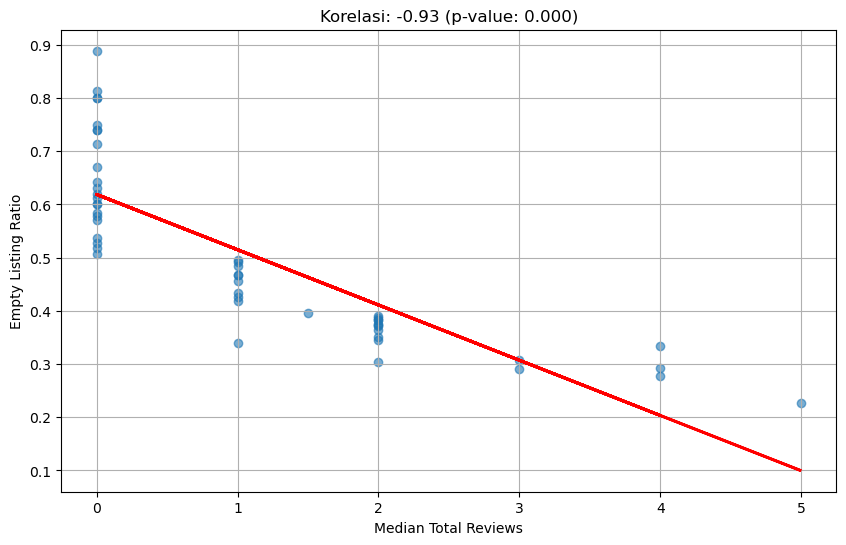

In [37]:
# Hitung korelasi Spearman
corr_coef, p_value = stats.spearmanr(
    empty_ratio['median_reviews'],
    empty_ratio['empty_ratio']
)

# Visualisasi
plt.figure(figsize=(10,6))
plt.scatter(
    x=empty_ratio['median_reviews'],
    y=empty_ratio['empty_ratio'],
    alpha=0.6
)
plt.title(f'Korelasi: {corr_coef:.2f} (p-value: {p_value:.3f})')
plt.xlabel('Median Total Reviews')
plt.ylabel('Empty Listing Ratio')
plt.grid(True)

# Tambah trendline
z = np.polyfit(empty_ratio['median_reviews'], empty_ratio['empty_ratio'], 1)
p = np.poly1d(z)
plt.plot(
    empty_ratio['median_reviews'], 
    p(empty_ratio['median_reviews']), 
    color='red',
    linewidth=2
)

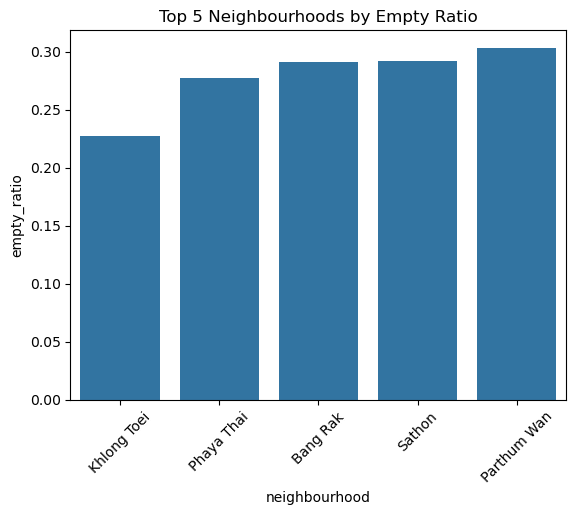

In [38]:
# Sort descending dan ambil top 5
top5 = empty_ratio.sort_values(by='empty_ratio', ascending=True).head(5)

# Plot barplot
sns.barplot(data=top5, x='neighbourhood', y='empty_ratio', 
            order=top5['neighbourhood'])
plt.xticks(rotation=45)  # Optional, kalau label-nya panjang
plt.title('Top 5 Neighbourhoods by Empty Ratio')
plt.show()

#### Insight of Empty Ratio Analysis

- Khlong Toei is the least empty ratio of all `neighbourhood`based on data with only 23% chance the listing will be empty
- Statistically proved, that there is negative correlation between `median_price` and `empty_ratio` (-0.29), which means the lower `empty_ratio` comes with the higher `median_price` a listing can put in the `neighbourhood`

### Conclusion: Analysis of Neighbourhood Recommendation

- Khlong Toei is the most recommended neighbourhood due to highest **Popularity Neighbourhood Analysis** and **Empty Ratio Analysis** and highly recommended in **Pricing Neighbourhood Analysis** calculation.
- Khlong Toei has the best `recency` analysis which the median data of `last_review` only 75 days. And the correlation analysis has proved that with the lower `recency` days, the higher `median_price`


## 2. Analysis of Best Room Type Recommendation

### Pricing Room Type Analysis

In [39]:
# Analysis room_type based on popularity (Global)
room_price_analysis = df_clean.groupby('room_type').agg(
    median_price=('price', 'median'),
    avg_price=('price', 'mean'),
    max_price=('price', 'max'),
    total_occupancy=('number_of_reviews', 'sum'),
    total_listings=('id', 'count'),
    median_min_night = ('minimum_nights', 'median'),
    avg_min_night = ('minimum_nights', 'mean'),
    revenue_at_least = ('revenue_at_least', 'sum'),
    avg_revenue_at_least = ('revenue_at_least', 'mean'),
    median_revenue_at_least = ('revenue_at_least', 'median')
).reset_index()

display(df_clean[['price','minimum_nights']].describe())
display(room_price_analysis.sort_values('revenue_at_least', ascending=False))

,price,minimum_nights
count,15854.00,15854.00
mean,3217.70,15.29
std,24972.12,50.82
min,0.00,1.00
25%,900.00,1.00
50%,1429.00,1.00
75%,2429.00,7.00
max,1100000.00,1125.00


,room_type,median_price,avg_price,max_price,total_occupancy,total_listings,median_min_night,avg_min_night,revenue_at_least,avg_revenue_at_least,median_revenue_at_least
0,Entire home/apt,1536.00,3465.47,1100000,197943,8912,3.00,20.51,16163565011,1813685.48,29970.00
2,Private room,1212.00,3064.60,600700,50710,5770,1.00,9.79,549808724,95287.47,0.00
1,Hotel room,1700.00,3028.31,300000,12700,649,1.00,1.84,44671499,68831.28,4930.00
3,Shared room,500.00,919.76,31200,2682,523,1.00,3.69,1596295,3052.19,0.00


In [40]:
# Analysis room_type based on popularity (Neighbourhood)
neighbourhood_room_stats = df_clean.groupby(['neighbourhood', 'room_type']).agg(
    median_price=('price', 'median'),
    avg_price=('price', 'mean'),
    total_occupancy=('number_of_reviews', 'sum'),
    max_price=('price', 'max'),
    total_listings=('id', 'count'),
    median_min_night = ('minimum_nights', 'median'),
    avg_min_night = ('minimum_nights', 'mean'),
    revenue_at_least = ('revenue_at_least', 'sum'),
    avg_revenue_at_least = ('revenue_at_least', 'mean'),
    median_revenue_at_least = ('revenue_at_least', 'median')
).reset_index()


display(df_clean[['price','minimum_nights']].describe())
display(neighbourhood_room_stats.sort_values('revenue_at_least', ascending=False).head(10))

,price,minimum_nights
count,15854.00,15854.00
mean,3217.70,15.29
std,24972.12,50.82
min,0.00,1.00
25%,900.00,1.00
50%,1429.00,1.00
75%,2429.00,7.00
max,1100000.00,1125.00


,neighbourhood,room_type,median_price,avg_price,total_occupancy,max_price,total_listings,median_min_night,avg_min_night,revenue_at_least,avg_revenue_at_least,median_revenue_at_least
72,Huai Khwang,Entire home/apt,1375.00,6222.61,14012,1000000.00,776,2.00,19.36,10092644838,13005985.62,15060.00
88,Khlong Toei,Entire home/apt,1732.00,3962.27,34377,1000000.00,1520,2.00,16.33,1476948168,971676.43,49997.00
116,Parthum Wan,Entire home/apt,2590.00,4213.94,7664,89215.00,255,5.00,31.46,1239231558,4859731.60,101964.00
24,Bang Na,Entire home/apt,979.50,1785.90,4630,35000.00,278,7.00,36.94,795925514,2863041.42,34412.50
188,Vadhana,Entire home/apt,2100.00,4699.07,32536,1100000.00,1451,3.00,17.77,614213157,423303.35,54579.00
148,Ratchathewi,Entire home/apt,1649.50,2159.84,13998,17281.00,656,3.00,19.20,312651725,476603.24,56093.50
164,Sathon,Entire home/apt,1400.00,2433.08,19566,200000.00,557,1.00,16.35,273249756,490574.07,27000.00
182,Thon buri,Private room,1140.00,4410.10,1886,161516.00,86,1.00,16.24,245314421,2852493.27,1862.00
52,Chatu Chak,Entire home/apt,1100.00,2950.44,5782,122594.00,273,4.00,31.41,224395508,821961.57,27540.00
84,Khlong San,Entire home/apt,1474.50,7395.77,4545,710760.00,186,21.00,33.06,201179222,1081608.72,97100.50


Text(0.5, 0.98, 'Top 5 Neighbourhoods Based on Pricing Neighbourhood Analysis')

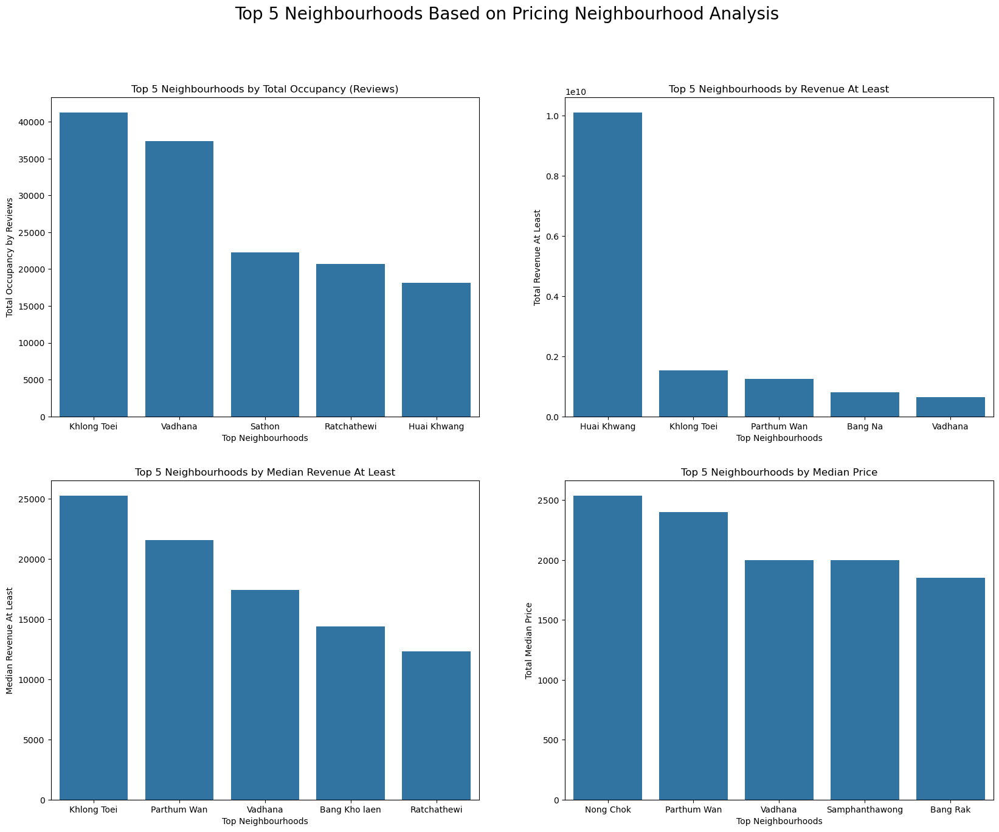

In [41]:
# Sort descending top 5
top5_total_revenue = neighbourhood_price_analysis.sort_values(by='revenue_at_least', ascending=False).head(5)

# Sort descending top 5
top5_median_revenue = neighbourhood_price_analysis.sort_values(by='median_revenue_at_least', ascending=False).head(5)

# Sort descending top 5
top5_occupancy = neighbourhood_price_analysis.sort_values(by='total_occupancy', ascending=False).head(5)

# Sort descending top 5
top5_median_price = neighbourhood_price_analysis.sort_values(by='median_price', ascending=False).head(5)

# Plot barplot
plt.figure(figsize = (20,15))
# Plot barplot
plt.subplot(2,2,1)
sns.barplot(data=top5_occupancy, 
            x='neighbourhood', 
            y='total_occupancy',
            order=top5_occupancy['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Occupancy by Reviews')
plt.title('Top 5 Neighbourhoods by Total Occupancy (Reviews)')

plt.subplot(2,2,2)
sns.barplot(data=top5_total_revenue, 
            x='neighbourhood', 
            y='revenue_at_least', 
            order=top5_total_revenue['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Revenue At Least')
plt.title('Top 5 Neighbourhoods by Revenue At Least')

# Plot barplot
plt.subplot(2,2,3)
sns.barplot(data=top5_median_revenue, 
            x='neighbourhood', 
            y='median_revenue_at_least', 
            order=top5_median_revenue['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Median Revenue At Least')
plt.title('Top 5 Neighbourhoods by Median Revenue At Least')

plt.subplot(2,2,4)
sns.barplot(data=top5_median_price, 
            x='neighbourhood', 
            y='median_price', 
            order=top5_median_price['neighbourhood'])
plt.xlabel('Top Neighbourhoods')
plt.ylabel('Total Median Price')
plt.title('Top 5 Neighbourhoods by Median Price')

plt.suptitle('Top 5 Neighbourhoods Based on Pricing Neighbourhood Analysis', fontsize=20)


#### Insight of Pricing Room Type Analysis
- All of top 10 room type in every neighbourhood is dominated by Entire home/apt
- Entire home/apt is leading in pricing and revenue based on room type and based on room type in every neighbourhood
- Entire home/apt is very versatile for property owner and guest due to comfort and large space and also has complete main facilities (bed, kitchen set, bathroom), therefore many guests can stay in entire home/apt for a long time.
- Hotel room has the highest median price due to the hotel’s standard to have high cleaning standard, good customer service, dining service, room service.
- Shared room is the least revenue at least due to not every traveller wants to share privacy with other travellers.
- Entire home/apt in Huai Khwang has the highest `revenue_at_least` which same as in Analysis of Best Neighbourhood Recommendation, the `median_revenue_at_least` is quite low (THB 15060)
- Entire home/apt in Khlong Toei is in the second place of highest `revenue_at_least`


### Popularity Room Type Analysis

In [42]:
# Analysis room_type based on popularity (Global)
room_analysis = df_clean.groupby('room_type').agg(
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_reviews_per_month=('reviews_per_month', 'median'),
    avg_reviews_per_month=('reviews_per_month', 'mean'),
    total_reviews_per_month=('reviews_per_month', 'sum'),
    recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    avg_last_review = ('recency', 'mean'),
    median_last_review = ('recency', 'median'),
    total_listings=('id', 'count')
).reset_index()

# Rekomendasi neighbourhood (top 5)
top_room_type = room_analysis.sort_values(
    by=['median_reviews', 'median_reviews_per_month', 'recent_reviews', 'median_last_review'],
    ascending=False
).head(5)

display(df_clean[['number_of_reviews','reviews_per_month', 'number_of_reviews_ltm']].describe())
display(top_room_type)

,number_of_reviews,reviews_per_month,number_of_reviews_ltm
count,15854.00,15854.00,15854.00
mean,16.65,0.52,3.48
std,40.61,0.95,8.92
min,0.00,0.00,0.00
25%,0.00,0.00,0.00
50%,2.00,0.09,0.00
75%,13.00,0.67,3.00
max,1224.00,19.13,325.00


,room_type,median_reviews,avg_reviews,total_reviews,median_reviews_per_month,avg_reviews_per_month,total_reviews_per_month,recent_reviews,avg_recent_reviews,total_recent_reviews,avg_last_review,median_last_review,total_listings
0,Entire home/apt,5.00,22.21,197943,0.30,0.71,6285.45,1.00,5.00,44535,3431.87,139.00,8912
1,Hotel room,2.00,19.57,12700,0.05,0.32,207.57,0.00,1.94,1258,4216.30,1188.00,649
2,Private room,0.00,8.79,50710,0.00,0.28,1632.41,0.00,1.59,9185,6465.55,12050.00,5770
3,Shared room,0.00,5.13,2682,0.00,0.11,58.06,0.00,0.42,218,7704.69,12050.00,523


In [43]:
# Analysis room_type based on popularity (Neighbourhood)
neighbourhood_room_analysis = df_clean.groupby(['neighbourhood', 'room_type']).agg(
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_reviews_per_month=('reviews_per_month', 'median'),
    avg_reviews_per_month=('reviews_per_month', 'mean'),
    total_reviews_per_month=('reviews_per_month', 'sum'),
    recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    avg_last_review = ('recency', 'mean'),
    median_last_review = ('recency', 'median'),
    total_listings=('id', 'count')
).reset_index()

# Rekomendasi neighbourhood (top 5)
top_room_type = neighbourhood_room_analysis.sort_values(
    by=['total_reviews', 'total_recent_reviews'],
    ascending=False
).head(10)

display(df_clean[['number_of_reviews','reviews_per_month', 'number_of_reviews_ltm']].describe())
display(top_room_type)

,number_of_reviews,reviews_per_month,number_of_reviews_ltm
count,15854.00,15854.00,15854.00
mean,16.65,0.52,3.48
std,40.61,0.95,8.92
min,0.00,0.00,0.00
25%,0.00,0.00,0.00
50%,2.00,0.09,0.00
75%,13.00,0.67,3.00
max,1224.00,19.13,325.00


,neighbourhood,room_type,median_reviews,avg_reviews,total_reviews,median_reviews_per_month,avg_reviews_per_month,total_reviews_per_month,recent_reviews,avg_recent_reviews,total_recent_reviews,avg_last_review,median_last_review,total_listings
88,Khlong Toei,Entire home/apt,9.00,22.62,34377,0.59,1.06,1609.52,3.00,8.17,12422,2043.40,41.00,1520
188,Vadhana,Entire home/apt,5.00,22.42,32536,0.40,0.82,1191.09,2.00,5.99,8692,3328.30,75.00,1451
164,Sathon,Entire home/apt,6.00,35.13,19566,0.54,0.82,458.50,2.00,5.14,2863,2648.06,55.00,557
72,Huai Khwang,Entire home/apt,3.00,18.06,14012,0.22,0.56,437.56,0.00,2.79,2167,3666.93,988.00,776
148,Ratchathewi,Entire home/apt,5.00,21.34,13998,0.37,0.69,455.72,1.00,5.01,3289,3302.65,123.00,656
32,Bang Rak,Entire home/apt,13.00,38.75,13600,0.60,0.93,327.80,2.00,7.41,2602,2033.45,63.00,351
124,Phaya Thai,Entire home/apt,15.00,50.52,10003,0.35,0.86,169.68,1.00,9.24,1829,2569.01,117.50,198
116,Parthum Wan,Entire home/apt,5.00,30.05,7664,0.40,0.66,167.33,1.00,4.92,1255,2961.72,120.00,255
52,Chatu Chak,Entire home/apt,7.00,21.18,5782,0.18,0.41,112.63,0.00,2.70,736,4128.67,1025.00,273
134,Phra Nakhon,Private room,3.00,14.20,5040,0.09,0.54,190.93,0.00,3.21,1141,4152.34,1092.00,355


#### Insight of Popularity Room Type Analysis

- 9 out of top 10 room type in every neighbourhood is dominated by Entire home/apt
- Entire home/apt in Khlong Toei is the most reviewed and has the most recent reviews within last 12 monts, and also has the least `avg_last_review` and `median_last_review` which makes Entire home/apt in Khlong Toei is the most popular room type and has the most promising prospect in the future

### Pricing and Popularity Analysis Visualization

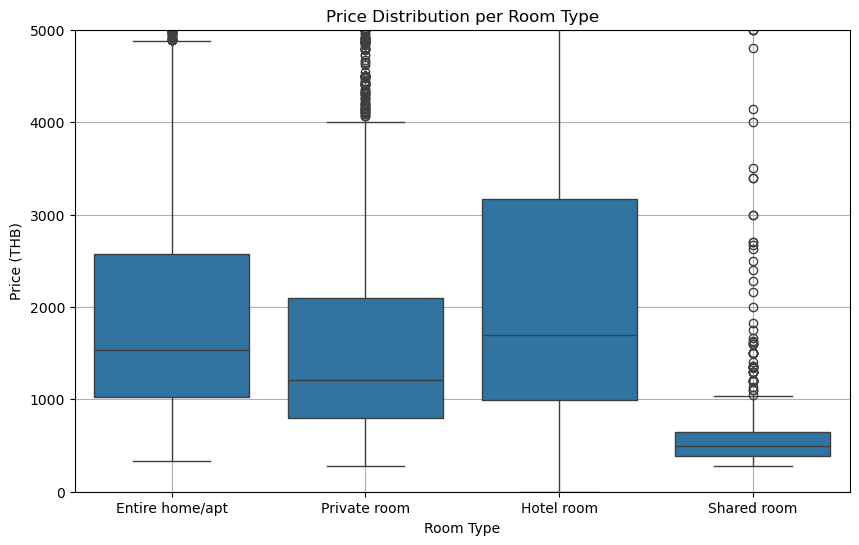

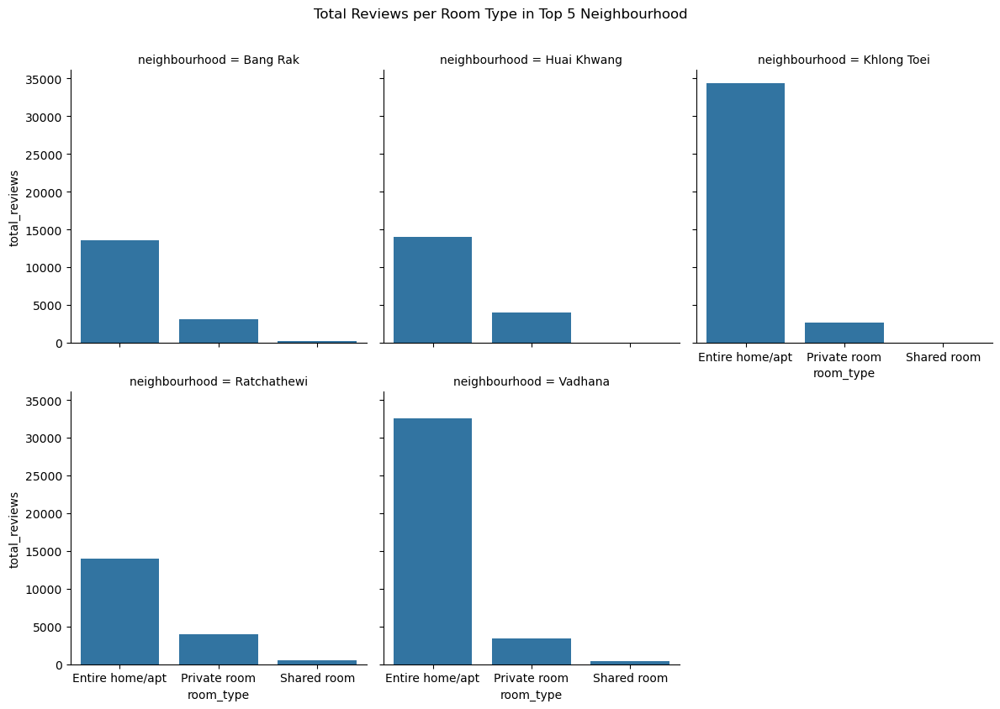

In [44]:
# 3. Analisis Room Type Global
room_type_stats = df_clean.groupby('room_type').agg(
    avg_price=('price', 'mean'),
    median_price=('price', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    avg_reviews_per_month=('reviews_per_month', 'mean'),
    total_listings=('id', 'count')
).reset_index()

# 4. Analisis per Neighbourhood
neighbourhood_room_stats = df.groupby(['neighbourhood', 'room_type']).agg(
    median_price=('price', 'median'),
    total_reviews=('number_of_reviews', 'sum'),
    avg_rating=('reviews_per_month', 'mean')
).reset_index()

plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='room_type', y='price')
plt.title('Price Distribution per Room Type')
plt.xlabel('Room Type')
plt.ylabel('Price (THB)')
plt.ylim(0, 5000)  # Sesuaikan batas atas jika perlu
plt.grid(True)
plt.show()

# Plot 3: Top Room Type per Neighbourhood
top_neighbourhoods = df['neighbourhood'].value_counts().head(5).index
sns.FacetGrid(
    data=neighbourhood_room_stats[neighbourhood_room_stats['neighbourhood'].isin(top_neighbourhoods)],
    col='neighbourhood',
    col_wrap=3,
    height=4
).map(
    sns.barplot, 
    'room_type', 
    'total_reviews', 
    order=['Entire home/apt', 'Private room', 'Shared room']
)
plt.suptitle('Total Reviews per Room Type in Top 5 Neighbourhood', y=1.05)

plt.show()




### Risk Management - Empty Ratio Analysis

In [45]:
empty_room_ratio = df_clean.groupby('room_type').agg(
    total_empty_listing=('empty_listing', 'sum'),
    median_price=('price', 'median'),
    total_listings=('id', 'count')
).reset_index()
empty_room_ratio['empty_ratio'] = empty_room_ratio['total_empty_listing'] / empty_room_ratio['total_listings']

display(empty_room_ratio.sort_values('empty_ratio', ascending=True).head(25))

,room_type,total_empty_listing,median_price,total_listings,empty_ratio
0,Entire home/apt,2344,1536.00,8912,0.26
1,Hotel room,199,1700.00,649,0.31
2,Private room,2929,1212.00,5770,0.51
3,Shared room,318,500.00,523,0.61


In [46]:
empty_room_ratio = df_clean.groupby(['neighbourhood','room_type']).agg(
    total_empty_listing=('empty_listing', 'sum'),
    median_price=('price', 'median'),
    total_listings=('id', 'count')
).reset_index()
empty_room_ratio['empty_ratio'] = empty_room_ratio['total_empty_listing'] / empty_room_ratio['total_listings']

display(empty_room_ratio.sort_values('empty_ratio', ascending=True).head(50))

,neighbourhood,room_type,total_empty_listing,median_price,total_listings,empty_ratio
97,Lat Krabang,Hotel room,0,1288.00,14,0.00
141,Pra Wet,Hotel room,0,1311.00,5,0.00
181,Thon buri,Hotel room,0,1400.00,1,0.00
13,Bang Khen,Hotel room,0,1286.00,3,0.00
183,Thon buri,Shared room,0,320.00,1,0.00
9,Bang Khae,Hotel room,0,750.00,1,0.00
17,Bang Kho laen,Hotel room,0,7765.00,2,0.00
137,Pom Prap Sattru Phai,Hotel room,0,745.00,11,0.00
5,Bang Kapi,Hotel room,0,600.00,1,0.00
125,Phaya Thai,Hotel room,3,850.00,26,0.12


#### Insight of Empty Ratio Analysis

- Room Type is the least empty ratio of all `room_type`based on data with only 26% chance the listing will be empty
- Statistically proved, that there is negative correlation between `median_price` and `empty_ratio` (-0.29), which means the lower `empty_ratio` comes with the higher `median_price` a listing can put in the `neighbourhood`
- It can be seen from the top 50 based on `revenue_at_least`, top 28 room_type are dominated by `Entire home/apt`

### Conclusion: Analysis of Room Type Recommendation

- `Entire home/apt` becomes the most recommended `room_type` to be listed based on `Pricing Room Type Analysis`, `Popularity Analysis` and `Empty Ratio Analysis`.
- `Entire home/apt` is the most appropriate choice because it is more comfortable and people tend to rent longer, thus providing greater revenue.
- From top 20 based on `Popularity Analysis`, `Entire home/apt` is still dominating with 16 `room_type` in each neighbourhood
- From `Empty Ratio Analysis`, Top 10 are dominated by `Hotel room` with total listing below than 100. Although it seems very promising to build an list a hotel room in Airbnb, also a businessman need to understand there are so many regulations and standards need to be complied to build a hotel and also need more budget
- From `Empty Ratio Analysis`, the empty ratio of `Entire home/apt` still promising which calculated around 15%-25%

## 3. Analysis of Pricing Strategy and Recommendation

### Pricing Analysis based on `neighbourhood` and `room_type` and popularity

Based on Best Recommendation of `neighbourhood` and `room_type`, the pricing analysis will be calculated for **Khlong Toei** dan juga untuk **Entire home/apt**

In [47]:
# Khlong Toei - Entire home/apt
khlong_toei_home_apt = df_clean[(df_clean['neighbourhood'] == 'Khlong Toei') & (df_clean['room_type'] == 'Entire home/apt')].sort_values('number_of_reviews', ascending=False)
display(khlong_toei_home_apt)


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,recency,revenue_at_least,empty_listing
3940,21065013,"The Muse Haus in Asoke ( Sleep 4,walk to BTS/MRT)",49539775,Max,Khlong Toei,13.73,100.56,Entire home/apt,2857,2,329,2022-12-16,5.19,36,62,13,1879906,0
847,6616352,Upmarket Loft Apartment in the Lively Heart of...,29821030,Diow,Khlong Toei,13.74,100.56,Entire home/apt,4056,1,323,2022-12-18,3.75,5,42,11,1310088,0
2398,15241184,Renovated Private 4 BR Townhouse @ BTS ONNUT,24147370,Anupong,Khlong Toei,13.71,100.59,Entire home/apt,4500,2,243,2022-12-24,3.34,5,47,5,2187000,0
2948,17162757,"Luxury 2 BR/2 Bath,3 Mins BTS NANA,GYM,POOL,WIFI",19146113,Pree,Khlong Toei,13.74,100.56,Entire home/apt,2800,2,227,2022-01-16,3.26,1,1,347,1271200,0
3109,17561011,2BR/wifi/1 min to BTS On nut/提供中文服务,44411390,Jeff,Khlong Toei,13.70,100.60,Entire home/apt,1800,1,218,2020-03-04,3.20,1,0,1030,392400,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10770,43004631,Soi48/luxury style/sukumvit road,342355962,ศิรินภา,Khlong Toei,13.71,100.59,Entire home/apt,3530,1,0,1990-01-01,0.00,1,0,12050,0,1
10732,42978873,tara Rama4/ true coffee,340124829,Phattha,Khlong Toei,13.72,100.58,Entire home/apt,3630,1,0,1990-01-01,0.00,1,0,12050,0,1
10718,42847791,1bed1bahts in Sukhumvit 48,340895332,Sirinya,Khlong Toei,13.71,100.59,Entire home/apt,3550,1,0,1990-01-01,0.00,1,0,12050,0,1
10684,42806644,Relax your life Enjoy your time .,340742751,Tidarat,Khlong Toei,13.71,100.59,Entire home/apt,1100,1,0,1990-01-01,0.00,1,0,12050,0,1


Remove all the `empty_listing` to get the better pricing strategy which there is no empty listing

In [48]:
# replace the empty_listing
nett_khlong_toei_home_apt = khlong_toei_home_apt[khlong_toei_home_apt['empty_listing'] == 0]

nett_khlong_toei_home_apt

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,recency,revenue_at_least,empty_listing
3940,21065013,"The Muse Haus in Asoke ( Sleep 4,walk to BTS/MRT)",49539775,Max,Khlong Toei,13.73,100.56,Entire home/apt,2857,2,329,2022-12-16,5.19,36,62,13,1879906,0
847,6616352,Upmarket Loft Apartment in the Lively Heart of...,29821030,Diow,Khlong Toei,13.74,100.56,Entire home/apt,4056,1,323,2022-12-18,3.75,5,42,11,1310088,0
2398,15241184,Renovated Private 4 BR Townhouse @ BTS ONNUT,24147370,Anupong,Khlong Toei,13.71,100.59,Entire home/apt,4500,2,243,2022-12-24,3.34,5,47,5,2187000,0
2948,17162757,"Luxury 2 BR/2 Bath,3 Mins BTS NANA,GYM,POOL,WIFI",19146113,Pree,Khlong Toei,13.74,100.56,Entire home/apt,2800,2,227,2022-01-16,3.26,1,1,347,1271200,0
3109,17561011,2BR/wifi/1 min to BTS On nut/提供中文服务,44411390,Jeff,Khlong Toei,13.70,100.60,Entire home/apt,1800,1,218,2020-03-04,3.20,1,0,1030,392400,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9540,40222374,"CBD Sukhumvit BTS Asoke, MRT QueenSirikit. Luxury",6477957,Ditthakorn (Olivia),Khlong Toei,13.72,100.56,Entire home/apt,900,30,1,2021-05-19,0.05,1,0,589,27000,0
12885,631300302157273881,Modern 1-bedroom on Sukhumvit near Convenient,61579423,Thiwaluck,Khlong Toei,13.73,100.56,Entire home/apt,1200,30,1,2022-09-21,0.30,7,1,99,36000,0
15046,761286893567617849,素坤逸/Ekkamai BTS/Gateway商场/曼谷大学/无边泳池/健身房,487618699,Yang,Khlong Toei,13.72,100.58,Entire home/apt,2099,1,1,2022-12-10,1.00,3,1,19,2099,0
14692,746978804298997142,"Lovely 2 bedrooms 68 Sqm, BTS Asok, Sukhumvit",122363222,Chonny,Khlong Toei,13.73,100.56,Entire home/apt,3400,1,1,2022-12-07,1.00,19,1,22,3400,0


In [49]:
display(nett_khlong_toei_home_apt['price'].quantile([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]))

q1 = nett_khlong_toei_home_apt['price'].quantile(0.25)
q3 = nett_khlong_toei_home_apt['price'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr

display(f'upper bound of price: {upper_bound}')

0.00       500.00
0.10       900.00
0.20      1143.00
0.30      1329.50
0.40      1529.00
0.50      1714.00
0.60      1919.00
0.70      2196.00
0.80      2871.00
0.90      4198.50
1.00   1000000.00
Name: price, dtype: float64

'upper bound of price: 4355.875'

#### Rule Based pricing segmentation analysis 

Pricing Segmentation Using Quantile Thresholds (`0.3`, `0.6`, and `Upper Bound`)
To build a more structured and market-reflective pricing strategy, a Rule-Based Pricing Segmentation approach is applied, using the price distribution's 0.3 quantile, 0.6 quantile, and the upper bound as reference points. These thresholds are used to divide listings into four pricing tiers: Standard, Business, First, and Suite Class.

- The 0.3 quantile (THB 1329.5) represents the upper limit of the budget segment, helping to define the Standard class.
- The 0.6 quantile (THB 1919) captures the transition into mid-to-high tier listings, making it a natural breakpoint for the Business and First class division.
- The Upper Bound (THB 4355.875) is calculated using statistical thresholds (often 1.5 * IQR) to separate outlier or luxury listings from the general market. It serves as the logical cutoff for the Suite Class segment.

Price Segmentation Entire home/apt in Khlong Toei:
- Standard Class: < THB 1329.5
- Business Class: THB 1329.5 - THB 1919 
- First Class: THB 1919 - THB 4355.875
- Suite Class: THB > 4355.875 



In [50]:

def price_segmentation(x):
    if x <= 1329.5:
        return 'Standard Class'
    elif x > 1329.5 and x <= 1919:
        return 'Business Class'
    elif x > 1919 and x <= 4355.875:
        return 'First Class'
    else:
        return 'Suite Class'
    
nett_khlong_toei_home_apt['price_category'] = nett_khlong_toei_home_apt['price'].apply(price_segmentation)

price_segment = nett_khlong_toei_home_apt.groupby('price_category').agg(
    avg_price=('price', 'mean'),
    median_price=('price', 'median'),
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_monthly_reviews=('reviews_per_month', 'median'),
    avg_monthly_reviews=('reviews_per_month', 'mean'),
    total_monthly_reviews=('reviews_per_month', 'sum'),
    median_recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    median_last_review=('recency', 'median'),
    avg_last_review=('recency', 'mean'),
    total_listings=('id', 'count'),
    median_min_night = ('minimum_nights', 'median'),
    avg_min_night = ('minimum_nights', 'mean'),
    revenue_at_least = ('revenue_at_least', 'sum'),
    avg_revenue_at_least = ('revenue_at_least', 'mean'),
    median_revenue_at_least = ('revenue_at_least', 'median')
).sort_values('avg_price', ascending=True).reset_index()


price_segment

,price_category,avg_price,median_price,median_reviews,avg_reviews,total_reviews,median_monthly_reviews,avg_monthly_reviews,total_monthly_reviews,median_recent_reviews,avg_recent_reviews,total_recent_reviews,median_last_review,avg_last_review,total_listings,median_min_night,avg_min_night,revenue_at_least,avg_revenue_at_least,median_revenue_at_least
0,Standard Class,1004.70,1010.50,8.00,21.52,8307,0.41,0.69,266.23,2.50,5.62,2169,54.50,328.61,386,5.00,22.76,171920975,445391.13,54000.00
1,Business Class,1629.93,1600.00,13.00,27.78,10889,0.94,1.36,532.88,6.00,9.35,3665,29.00,206.66,392,2.00,9.25,131609105,335737.51,70021.00
2,First Class,2681.34,2500.00,17.00,30.33,11647,1.13,1.65,635.26,8.00,12.73,4887,18.00,139.65,384,1.00,7.72,129277840,336661.04,76729.00
3,Suite Class,26519.62,5866.50,17.50,28.50,3534,1.00,1.41,175.15,7.50,13.72,1701,21.50,199.91,124,1.00,12.85,1044140248,8420485.87,167642.50


### Conclusion: Analysis of Best Price Recommendation

1. Class Segmentation and Business Strategy

| **Class**         | **Price Range (THB)**     | **Target Audience**                                                                                     | **Facilities & Features**                                                                                                                                                                                                 |
|--------------------|---------------------------|---------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| **Suite Class**    | > 4355.875               | High-income travelers, business executives, luxury vacationers                                          | - Premium locations (e.g., Sukhumvit Road, near BTS Asoke/Thonglor).<br>- High-end facilities: private pool, rooftop view, gym, sauna.<br>- Concierge services and daily housekeeping.<br>- Luxurious interior design.     |
| **First Class**    | 1919 - 4355.875          | Families, couples, or professionals seeking comfort at competitive prices                               | - Near BTS/MRT stations (e.g., On Nut, Phra Khanong).<br>- Fully equipped kitchen, modern furniture.<br>- Family-friendly amenities (cribs, high chairs).<br>- Discounts for weekly/monthly stays.                        |
| **Business Class** | 1329.5 - 1919            | Solo travelers, business professionals with mid-range budgets                                           | - Proximity to business hubs (e.g., Rama IV Road, Sukhumvit).<br>- Ergonomic workspace with high-speed Wi-Fi.<br>- Flexible check-in/out options for short stays.<br>- Compact and functional design.                      |
| **Standard Class** | < 1329.5                 | Backpackers, students, budget-conscious travelers                                                       | - Affordable locations near local markets or less central areas.<br>- Basic amenities: clean bed, AC, Wi-Fi.<br>- Shared kitchen or laundry facilities.<br>- Group discounts or long-term rental offers.                   |

2. First Class price segmentation is the most popular price segment with the highest `total_reviews` and `total_recent_reviews` and lowest `median_last_review` and `avg_last_review` which means first class price segment is the most recent price segment to be reviewed and occupied
3. Based on `revenuw_at_least` the highest is from the Suite Class price segment followed by Business Class in the second place
4. First Class price segment is very recommendeded for open a listing in Airbnb due to popularity and have more prospects for long term due to most recent_reviews and the host can charge over 50% price more than the Business Class

## 4. Analysis of Host Listing Strategy and Recommendation

Based on Best Recommendation of `neighbourhood` and `room_type`, the pricing analysis will be calculated for **Khlong Toei** dan juga untuk **Entire home/apt**

In [51]:
listing_khlong_toei_home_apt = nett_khlong_toei_home_apt.groupby('host_name').agg(
    total_listings=('id', 'count'),
    avg_price=('price', 'mean'),
    median_price=('price', 'median'),
    median_reviews=('number_of_reviews', 'median'),
    avg_reviews=('number_of_reviews', 'mean'),
    total_reviews=('number_of_reviews', 'sum'),
    median_monthly_reviews=('reviews_per_month', 'median'),
    avg_monthly_reviews=('reviews_per_month', 'mean'),
    total_monthly_reviews=('reviews_per_month', 'sum'),
    median_recent_reviews=('number_of_reviews_ltm', 'median'),
    avg_recent_reviews=('number_of_reviews_ltm', 'mean'),
    total_recent_reviews=('number_of_reviews_ltm', 'sum'),
    median_last_review=('recency', 'median'),
    avg_last_review=('recency', 'mean'),
    median_min_night = ('minimum_nights', 'median'),
    avg_min_night = ('minimum_nights', 'mean')
).sort_values('total_listings', ascending=False).reset_index()

listing_khlong_toei_home_apt.head(25)

,host_name,total_listings,avg_price,median_price,median_reviews,avg_reviews,total_reviews,median_monthly_reviews,avg_monthly_reviews,total_monthly_reviews,median_recent_reviews,avg_recent_reviews,total_recent_reviews,median_last_review,avg_last_review,median_min_night,avg_min_night
0,Curry,51,3008.41,2243.00,18.00,26.96,1375,1.44,1.49,75.96,11.00,15.39,785,18.00,25.69,1.00,1.00
1,Summer,36,1842.03,1815.50,16.00,21.19,763,0.53,0.73,26.44,6.50,9.25,333,19.00,66.28,2.00,3.42
2,Noons,32,2536.34,2099.00,17.50,23.12,740,0.98,1.24,39.59,10.00,12.50,400,21.50,34.94,1.00,1.00
3,Cora,30,80716.30,995.00,4.50,9.70,291,0.15,0.29,8.80,2.00,1.90,57,126.00,368.27,3.00,13.33
4,Ken-Bambu,27,2869.96,2500.00,10.00,11.37,307,2.35,2.34,63.29,10.00,10.41,281,12.00,12.85,2.00,2.00
5,Camila,26,1078.19,1042.00,2.00,2.12,55,0.05,0.05,1.38,0.00,0.08,2,1130.50,1051.65,28.00,21.77
6,Yefeng,24,4449.46,4290.50,37.00,41.50,996,2.33,2.22,53.30,29.50,29.25,702,15.00,15.88,1.00,1.00
7,Nana,23,2525.70,2179.00,11.00,15.87,365,1.09,1.22,28.01,6.00,8.48,195,34.00,66.52,1.00,1.04
8,Sophia,23,1655.22,1485.00,14.00,18.09,416,1.13,1.28,29.51,14.00,16.39,377,24.00,35.52,1.00,2.26
9,Erica,22,827.95,786.00,8.00,9.18,202,0.24,0.27,5.86,2.00,2.73,60,109.00,220.32,28.00,22.00


In [52]:
display(listing_khlong_toei_home_apt['total_listings'].quantile([0, 0.25, 0.5, 0.75, 1]))
display(listing_khlong_toei_home_apt['total_listings'].quantile([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]))

q1 = listing_khlong_toei_home_apt['total_listings'].quantile(0.25)
q3 = listing_khlong_toei_home_apt['total_listings'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr

display(f'upper bound of total host listing: {upper_bound}')
display(listing_khlong_toei_home_apt['total_listings'].shape)

0.00    1.00
0.25    1.00
0.50    1.00
0.75    2.00
1.00   51.00
Name: total_listings, dtype: float64

0.00    1.00
0.10    1.00
0.20    1.00
0.30    1.00
0.40    1.00
0.50    1.00
0.60    1.00
0.70    2.00
0.80    3.00
0.90    8.00
1.00   51.00
Name: total_listings, dtype: float64

'upper bound of total host listing: 3.5'

(405,)

#### Rule Based total host listing segmentation analysis:
- High Capital Reserve: total listings > THB 8
- Middle Capital Reserve: total listings between 2 - 8
- Low Capital Reserve: 1 listing

In [53]:
def listing_segmentation(x):
    if x == 1:
        return 'Low Capital Reserve'
    elif x > 1 and x <= 8:
        return 'Middle Capital Reserve'
    else:
        return 'High Capital Reserve'
    
listing_khlong_toei_home_apt['listing_segmentation'] = listing_khlong_toei_home_apt['total_listings'].apply(listing_segmentation)

listing_segment = listing_khlong_toei_home_apt.groupby('listing_segmentation').agg(
    total_host = ('host_name', 'count'),
    avg_price=('avg_price', 'mean'),
    median_price=('median_price', 'median'),
    median_reviews=('median_reviews', 'median'),
    avg_reviews=('avg_reviews', 'mean'),
    total_reviews=('total_reviews', 'sum'),
    median_monthly_reviews=('median_monthly_reviews', 'median'),
    avg_monthly_reviews=('avg_monthly_reviews', 'mean'),
    total_monthly_reviews=('total_monthly_reviews', 'sum'),
    median_recent_reviews=('median_recent_reviews', 'median'),
    avg_recent_reviews=('avg_recent_reviews', 'mean'),
    total_recent_reviews=('total_recent_reviews', 'sum'),
    median_last_review=('median_last_review', 'median'),
    avg_last_review=('avg_last_review', 'mean'),
    median_min_night = ('median_min_night', 'median'),
    avg_min_night = ('avg_min_night', 'mean')
).sort_values('total_host', ascending=True).reset_index()

listing_segment['revenue_at_least'] = listing_segment['total_reviews'] * listing_segment['median_min_night'] * listing_segment['median_price']

listing_segment

,listing_segmentation,total_host,avg_price,median_price,median_reviews,avg_reviews,total_reviews,median_monthly_reviews,avg_monthly_reviews,total_monthly_reviews,median_recent_reviews,avg_recent_reviews,total_recent_reviews,median_last_review,avg_last_review,median_min_night,avg_min_night,revenue_at_least
0,High Capital Reserve,36,4409.99,1790.00,14.50,26.48,16270,1.11,1.45,931.23,8.00,11.69,7694,22.00,144.44,2.00,9.06,58246600.00
1,Middle Capital Reserve,115,2316.91,1500.00,14.00,27.12,11876,0.76,1.12,493.65,4.00,7.94,3704,38.50,249.28,3.00,17.46,53442000.00
2,Low Capital Reserve,254,2318.56,1500.00,9.00,24.53,6231,0.40,0.73,184.64,2.00,4.03,1024,60.50,478.44,5.00,27.66,46732500.00


### Insight: Analysis of Host Listing Strategy and Recommendation

1. Host Listing Strategy

| **Capital Reserve**     | **Total Listings per Host** | **Target Audience**                                                                                     | **Strategy**                                                                                                                                                                                                 |
|--------------------------|----------------------------|---------------------------------------------------------------------------------------------------------|-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| **High Capital Reserve** | > 8                       | Professional property managers or investors with multiple properties                                    | - Focus on premium locations like Sukhumvit Road or near BTS Asoke.<br>- Offer diverse property options (e.g., luxury apartments, family-friendly units).<br>- Provide consistent branding and professional management services. |
| **Middle Capital Reserve** | 2 - 8                   | Small-scale property owners or aspiring investors                                                        | - Optimize mid-range properties near BTS On Nut or Phra Khanong.<br>- Offer flexible pricing for short-term and long-term stays.<br>- Focus on providing high-quality amenities to attract repeat customers. |
| **Low Capital Reserve**  | 1                         | Individual hosts with a single property                                                                 | - Concentrate on affordability and niche markets.<br>- Highlight unique features of the property (e.g., rooftop views, proximity to local attractions).<br>- Use personalized hosting to enhance guest experience. |

2. High Capital Reserve segment with more than 8 listings in Khlong Toei leads all the `pricing`, `total reviews`, `recent reviews`, `last review date`

## Conclusion Statement

1. **Khlong Toei** is the best `neighourhood` recommendation to build and list a property on Airbnb due to the most popular `neighbourhood` in Bangkok based on Airbnb `number_of_reviews` and `reviews_per_month` and has the most business prospect in the future due to the most recent `number_of_reviews_ltm` and the least days of `last_review`. Also in the pricing analysis, Khlong Toei shows the highest `median_revenue_at_least` which means better price distribution for every listing.

2. **Entire home/apt** is the best `room_type` recommendation to build an list a property on Airbnb due to the most popular `room_type` in every `neighbourhood` in Bangkok based on Airbnb `number_of_reviews` and `reviews_per_month` and has the most business prospect in the future due to the most recent `number_of_reviews_ltm` and the least days of `last_review`. Also in the pricing analysis, Entire home/apt shows the highest `revenue_at_least` and `median_revenue_at_least`.

3. **Pricing Strategy and Recommendation** can be adjusted based on the host's financial conditions, target audience, and the location of the listed property. If all the conditions can be managed, then **First Class** and **Suite Class** price segmentation can be the recommendation due to the most popular and the most revenue price segments.

| **Class**         | **Price Range (THB)**     | **Target Audience**                                                                                     | **Facilities & Features**                                                                                                                                                                                                 |
|--------------------|---------------------------|---------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| **Suite Class**    | > 4355.875               | High-income travelers, business executives, luxury vacationers                                          | - Premium locations (e.g., Sukhumvit Road, near BTS Asoke/Thonglor).<br>- High-end facilities: private pool, rooftop view, gym, sauna.<br>- Concierge services and daily housekeeping.<br>- Luxurious interior design.     |
| **First Class**    | 1919 - 4355.875          | Families, couples, or professionals seeking comfort at competitive prices                               | - Near BTS/MRT stations (e.g., On Nut, Phra Khanong).<br>- Fully equipped kitchen, modern furniture.<br>- Family-friendly amenities (cribs, high chairs).<br>- Discounts for weekly/monthly stays.                        |
| **Business Class** | 1329.5 - 1919            | Solo travelers, business professionals with mid-range budgets                                           | - Proximity to business hubs (e.g., Rama IV Road, Sukhumvit).<br>- Ergonomic workspace with high-speed Wi-Fi.<br>- Flexible check-in/out options for short stays.<br>- Compact and functional design.                      |
| **Standard Class** | < 1329.5                 | Backpackers, students, budget-conscious travelers                                                       | - Affordable locations near local markets or less central areas.<br>- Basic amenities: clean bed, AC, Wi-Fi.<br>- Shared kitchen or laundry facilities.<br>- Group discounts or long-term rental offers.                   |

# Clean Data Extraction

In [54]:
df_clean['empty_listing'] = df_clean['empty_listing'].astype(int)
nett_khlong_toei_home_apt['price_category'] = nett_khlong_toei_home_apt['price_category'].astype('category')
display(df_clean.info())
display(nett_khlong_toei_home_apt.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              15854 non-null  object        
 1   name                            15854 non-null  object        
 2   host_id                         15854 non-null  object        
 3   host_name                       15854 non-null  object        
 4   neighbourhood                   15854 non-null  category      
 5   latitude                        15854 non-null  float64       
 6   longitude                       15854 non-null  float64       
 7   room_type                       15854 non-null  category      
 8   price                           15854 non-null  int64         
 9   minimum_nights                  15854 non-null  int64         
 10  number_of_reviews               15854 non-null  int64         
 11  la

None

<class 'pandas.core.frame.DataFrame'>
Index: 1286 entries, 3940 to 9270
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              1286 non-null   object        
 1   name                            1286 non-null   object        
 2   host_id                         1286 non-null   object        
 3   host_name                       1286 non-null   object        
 4   neighbourhood                   1286 non-null   category      
 5   latitude                        1286 non-null   float64       
 6   longitude                       1286 non-null   float64       
 7   room_type                       1286 non-null   category      
 8   price                           1286 non-null   int64         
 9   minimum_nights                  1286 non-null   int64         
 10  number_of_reviews               1286 non-null   int64         
 11  last_r

None

In [55]:
df_clean.to_csv('Airbnb Listings Bangkok Clean.csv', index=False)

In [56]:
nett_khlong_toei_home_apt.to_csv('Airbnb Listings Bangkok Recommendation.csv', index=False)

In [57]:
df_clean_dates.to_csv('Airbnb Listings Bangkok Clean Date.csv', index=False)